In [37]:
# This fixes it permanently but requires runtime restart
#!pip install --upgrade jupyter-client
# Then: Runtime → Restart runtime

In [38]:
pip install git+https://github.com/openai/CLIP.git

  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-16ti9e5p
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-16ti9e5p
  Resolved https://github.com/openai/CLIP.git to commit ded190a052fdf4585bd685cee5bc96e0310d2c93
  Preparing metadata (setup.py) ... done


In [39]:
# Install required packages
!pip install torch torchvision transformers pillow requests ddgs

In [40]:
import warnings
import os

# Ignore all warnings
warnings.filterwarnings('ignore')

# Also suppress warnings at the environment level
os.environ['PYTHONWARNINGS'] = 'ignore'

In [41]:
import time
from ddgs import DDGS
import requests
from PIL import Image
from io import BytesIO
import os

def robust_download(query, folder_name, target=100, delay=30):
    """
    Download with retry logic and multiple attempts
    """
    os.makedirs(folder_name, exist_ok=True)

    downloaded = 0
    attempt = 0
    max_attempts = 3

    while downloaded < target and attempt < max_attempts:
        attempt += 1

        if attempt > 1:
            print(f"\nAttempt {attempt}/{max_attempts} (need {target - downloaded} more images)...")
            print(f"Waiting {delay} seconds to avoid rate limit...")
            time.sleep(delay)
        else:
            print(f"Downloading '{query}' to {folder_name}/...")

        try:
            with DDGS() as ddgs:
                # Request more than needed since some will fail
                results = list(ddgs.images(query, max_results=min(150, (target - downloaded) * 2)))

                for idx, result in enumerate(results):
                    if downloaded >= target:
                        break

                    try:
                        response = requests.get(result['image'], timeout=5)
                        img = Image.open(BytesIO(response.content)).convert('RGB')

                        # Save with unique filename
                        filename = f'image_{downloaded:03d}.jpg'
                        filepath = os.path.join(folder_name, filename)
                        img.save(filepath)

                        downloaded += 1

                        if downloaded % 10 == 0:
                            print(f"  Progress: {downloaded}/{target}...")

                    except Exception as e:
                        continue

            print(f"✓ Attempt {attempt}: Downloaded {downloaded} total images")

        except Exception as e:
            print(f"✗ Attempt {attempt} failed: {e}")
            if "403" in str(e) or "Forbidden" in str(e):
                print("  Rate limited - will retry after delay")

    # Get final count
    final_files = [f for f in os.listdir(folder_name)
                   if f.endswith(('.jpg', '.png', '.jpeg'))]

    print(f"✓ Final: {len(final_files)} images in {folder_name}/\n")

    return [os.path.join(folder_name, f) for f in sorted(final_files)]



image_paths = robust_download('white wedding dress', 'wedding_dresses', target=100)

# Wait before venues (avoid rate limit)
time.sleep(60)

venue_paths = robust_download('wedding venue', 'wedding_venues', target=100)  # Simpler query

time.sleep(60)

shoe_paths = robust_download('wedding shoes bridal', 'wedding_shoes', target=100)


print(f"Dresses: {len(image_paths)}")
print(f"Venues:  {len(venue_paths)}")
print(f"Shoes:   {len(shoe_paths)}")

✗ Attempt 1 failed: No results found.

Attempt 2/3 (need 100 more images)...
Waiting 30 seconds to avoid rate limit...
✗ Attempt 2 failed: No results found.

Attempt 3/3 (need 100 more images)...
Waiting 30 seconds to avoid rate limit...
  Progress: 10/100...
  Progress: 20/100...
  Progress: 30/100...
  Progress: 40/100...
  Progress: 50/100...
  Progress: 60/100...
✓ Attempt 3: Downloaded 69 total images
✓ Final: 100 images in wedding_dresses/

✗ Attempt 1 failed: No results found.

Attempt 2/3 (need 100 more images)...
Waiting 30 seconds to avoid rate limit...
✗ Attempt 2 failed: No results found.

Attempt 3/3 (need 100 more images)...
Waiting 30 seconds to avoid rate limit...
✗ Attempt 3 failed: No results found.
✓ Final: 100 images in wedding_venues/

✗ Attempt 1 failed: No results found.

Attempt 2/3 (need 100 more images)...
Waiting 30 seconds to avoid rate limit...
  Progress: 10/100...
  Progress: 20/100...
  Progress: 30/100...
  Progress: 40/100...
  Progress: 50/100...
  Pr

In [42]:
from PIL import Image
import requests
from transformers import CLIPProcessor, CLIPModel
from io import BytesIO
import torch

# Load CLIP model
model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

# Move to GPU if available
device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

Loading weights:   0%|          | 0/398 [00:00<?, ?it/s]

CLIPModel LOAD REPORT from: openai/clip-vit-base-patch32
Key                                  | Status     |  | 
-------------------------------------+------------+--+-
text_model.embeddings.position_ids   | UNEXPECTED |  | 
vision_model.embeddings.position_ids | UNEXPECTED |  | 

Notes:
- UNEXPECTED	:can be ignored when loading from different task/architecture; not ok if you expect identical arch.


CLIPModel(
  (text_model): CLIPTextTransformer(
    (embeddings): CLIPTextEmbeddings(
      (token_embedding): Embedding(49408, 512)
      (position_embedding): Embedding(77, 512)
    )
    (encoder): CLIPEncoder(
      (layers): ModuleList(
        (0-11): 12 x CLIPEncoderLayer(
          (self_attn): CLIPAttention(
            (k_proj): Linear(in_features=512, out_features=512, bias=True)
            (v_proj): Linear(in_features=512, out_features=512, bias=True)
            (q_proj): Linear(in_features=512, out_features=512, bias=True)
            (out_proj): Linear(in_features=512, out_features=512, bias=True)
          )
          (layer_norm1): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
          (mlp): CLIPMLP(
            (activation_fn): QuickGELUActivation()
            (fc1): Linear(in_features=512, out_features=2048, bias=True)
            (fc2): Linear(in_features=2048, out_features=512, bias=True)
          )
          (layer_norm2): LayerNorm((512,), eps=1e-05,

In [43]:
def batch_classify(image_paths, labels, descriptions=None, batch_size=8):
    """
    Classify multiple images efficiently
    """
    results = []

    for i in range(0, len(image_paths), batch_size):
        batch_paths = image_paths[i:i+batch_size]

        # Load images
        images = []
        for path in batch_paths:
            if path.startswith('http'):
                response = requests.get(path)
                images.append(Image.open(BytesIO(response.content)))
            else:
                images.append(Image.open(path))

        # Create prompts
        if descriptions is None:
            texts = [f"a photo of a {label} wedding dress" for label in labels]
        else:
            texts = descriptions

        # Process batch
        inputs = processor(
            text=texts,
            images=images,
            return_tensors="pt",
            padding=True
        ).to(device)

        with torch.no_grad():
            outputs = model(**inputs)
            logits_per_image = outputs.logits_per_image
            probs = logits_per_image.softmax(dim=1)

        # Store results
        for j, (path, prob_dist) in enumerate(zip(batch_paths, probs)):
            results.append({
                'image_path': path,
                'predicted_label': labels[prob_dist.argmax().item()],
                'confidence': prob_dist.max().item(),
                'probabilities': {label: prob.item() for label, prob in zip(labels, prob_dist)}
            })

    return results

results = batch_classify(image_paths, labels=['romantic', 'modern', 'dramatic', 'traditional'])

for r in results:
    print(f"{r['image_path']}: {r['predicted_label']} ({r['confidence']:.2%})")

wedding_dresses/image_000.jpg: modern (71.77%)
wedding_dresses/image_001.jpg: modern (42.85%)
wedding_dresses/image_002.jpg: modern (66.59%)
wedding_dresses/image_003.jpg: modern (72.93%)
wedding_dresses/image_004.jpg: modern (68.16%)
wedding_dresses/image_005.jpg: modern (53.83%)
wedding_dresses/image_006.jpg: modern (47.11%)
wedding_dresses/image_007.jpg: romantic (47.41%)
wedding_dresses/image_008.jpg: modern (35.15%)
wedding_dresses/image_009.jpg: modern (59.14%)
wedding_dresses/image_010.jpg: modern (76.54%)
wedding_dresses/image_011.jpg: modern (62.03%)
wedding_dresses/image_012.jpg: modern (58.18%)
wedding_dresses/image_013.jpg: dramatic (39.49%)
wedding_dresses/image_014.jpg: romantic (41.60%)
wedding_dresses/image_015.jpg: modern (34.33%)
wedding_dresses/image_016.jpg: romantic (41.94%)
wedding_dresses/image_017.jpg: romantic (42.74%)
wedding_dresses/image_018.jpg: dramatic (70.75%)
wedding_dresses/image_019.jpg: modern (74.96%)
wedding_dresses/image_020.jpg: modern (57.92%)
w

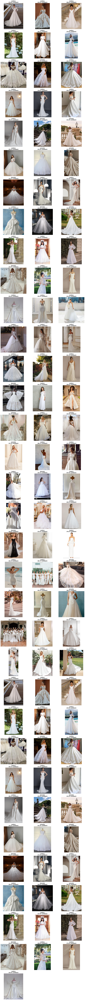

In [44]:
import matplotlib.pyplot as plt
from PIL import Image
import requests
from io import BytesIO

def display_predictions(image_paths, predictions, n_cols=3):
    """
    Display images in a grid with their predicted labels
    """
    n_images = len(image_paths)
    n_rows = (n_images + n_cols - 1) // n_cols

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5*n_rows))
    axes = axes.flatten() if n_images > 1 else [axes]

    for idx, (img_path, pred) in enumerate(zip(image_paths, predictions)):
        # Load image
        if img_path.startswith('http'):
            response = requests.get(img_path)
            img = Image.open(BytesIO(response.content))
        else:
            img = Image.open(img_path)

        # Display
        axes[idx].imshow(img)
        axes[idx].axis('off')

        # Add label as title
        label = pred['predicted_label']
        confidence = pred['confidence']
        axes[idx].set_title(f"{label}\n({confidence:.1%} confident)",
                           fontsize=12, fontweight='bold')

    # Hide unused subplots
    for idx in range(n_images, len(axes)):
        axes[idx].axis('off')

    plt.tight_layout()
    plt.show()

predictions = batch_classify(image_paths, labels=['romantic', 'modern', 'dramatic', 'traditional'])

display_predictions(image_paths, predictions)

## Switching Domains

In [45]:
labels = ['romantic', 'modern', 'dramatic', 'traditional']

print("CLASSIFYING WEDDING DRESSES...")
dress_predictions = predictions

print("CLASSIFYING WEDDING VENUES...")
venue_predictions = batch_classify(venue_paths, labels=labels)

print("CLASSIFYING WEDDING SHOES...")
shoe_predictions = batch_classify(shoe_paths, labels=labels)

CLASSIFYING WEDDING DRESSES...
CLASSIFYING WEDDING VENUES...
CLASSIFYING WEDDING SHOES...


In [46]:
print("DOMAIN SHIFT ANALYSIS: LABEL DISTRIBUTION")

def analyze_predictions(predictions, domain_name):
    """Show distribution of labels"""
    print(f"\n{domain_name.upper()} ({len(predictions)} images):")
    for label in labels:
        count = sum(1 for p in predictions if p['predicted_label'] == label)
        pct = count / len(predictions) * 100
        bar = "█" * int(pct / 5)
        print(f"  {label:12} {count:3} ({pct:5.1f}%) {bar}")

analyze_predictions(dress_predictions, "Dresses")
analyze_predictions(venue_predictions, "Venues")
#analyze_predictions(shoe_predictions, "Shoes")

DOMAIN SHIFT ANALYSIS: LABEL DISTRIBUTION

DRESSES (100 images):
  romantic      15 ( 15.0%) ███
  modern        73 ( 73.0%) ██████████████
  dramatic      12 ( 12.0%) ██
  traditional    0 (  0.0%) 

VENUES (100 images):
  romantic      89 ( 89.0%) █████████████████
  modern         7 (  7.0%) █
  dramatic       4 (  4.0%) 
  traditional    0 (  0.0%) 


In [47]:
print("AVERAGE CONFIDENCE BY DOMAIN")

def avg_confidence(predictions):
    return sum(p['confidence'] for p in predictions) / len(predictions)

dress_conf = avg_confidence(dress_predictions)
venue_conf = avg_confidence(venue_predictions)
#shoe_conf = avg_confidence(shoe_predictions)

print(f"\nDresses: {dress_conf:.1%} average confidence")
print(f"Venues:  {venue_conf:.1%} average confidence")
#print(f"Shoes:   {shoe_conf:.1%} average confidence")

AVERAGE CONFIDENCE BY DOMAIN

Dresses: 54.1% average confidence
Venues:  55.5% average confidence


SAMPLE PREDICTIONS FROM EACH DOMAIN

 Dresses


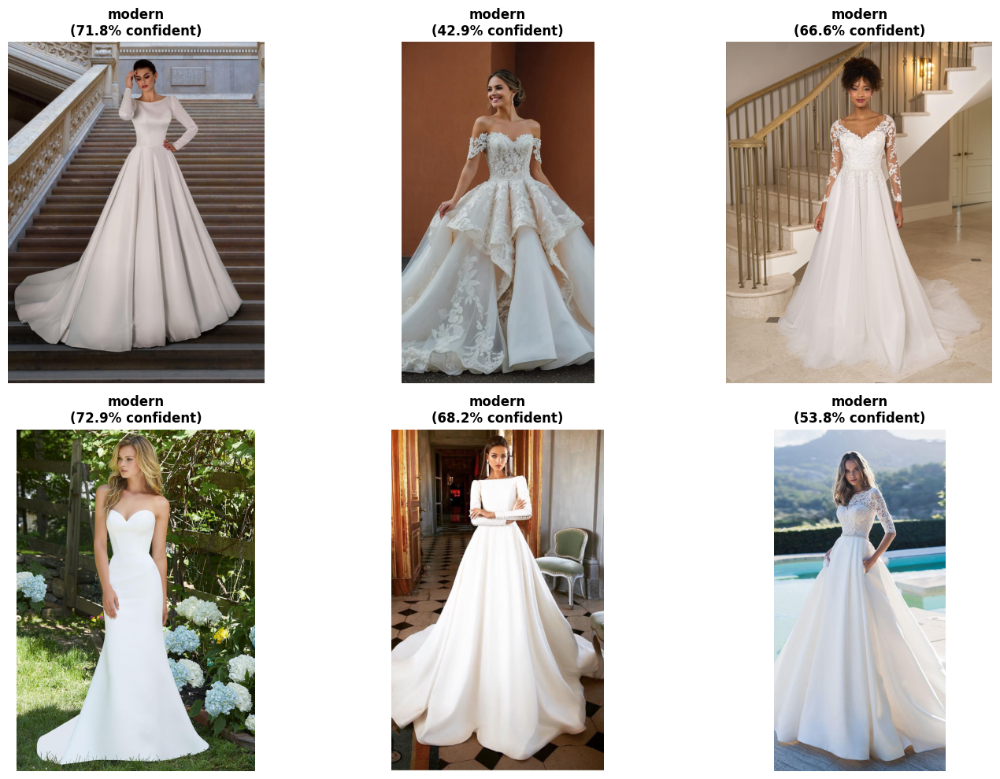


 Venues


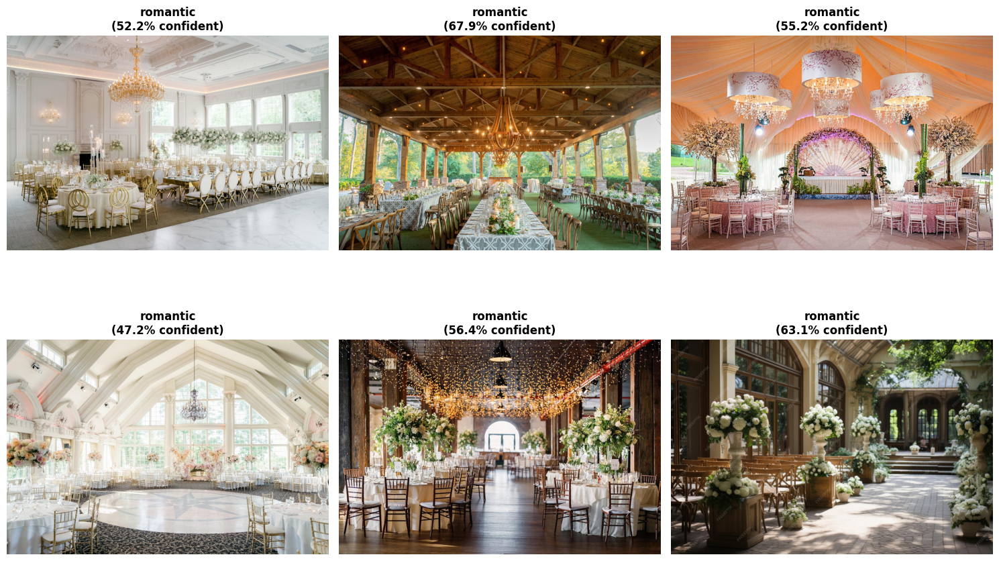


 Shoes


In [48]:
print("SAMPLE PREDICTIONS FROM EACH DOMAIN")

print("\n Dresses")
display_predictions(image_paths[:6], dress_predictions[:6])

print("\n Venues")
display_predictions(venue_paths[:6], venue_predictions[:6])

print("\n Shoes")
#display_predictions(shoe_paths[:6], shoe_predictions[:6])

## Refining prompts

In [49]:
labels =['romantic', 'modern', 'dramatic', 'traditional']
# Define all prompt strategies
simple_prompts = None  # Default: "a photo of {label} wedding dress"

detailed_prompts = ['Romantic wedding aesthetic—soft, feminine, delicate lace or tulle, gentle draping, subtle sparkle',
                    'Modern wedding aesthetic—clean, minimalist, and design-forward with crisp lines, sleek silhouettes, and unique cuts',
                    'Dramatic wedding aesthetic—bold, high-contrast, and cinematic, statement silhouettes, luxe textures',
                    'Traditional wedding aesthetic—classic, formal, and elegant with refined silhouettes, structured details, heritage-inspired elements, and timeless neutral palettes']

# Classify dresses with each strategy
dress_predictions_simple = batch_classify(image_paths, labels=labels, descriptions=simple_prompts)

dress_predictions_detailed = batch_classify(image_paths, labels=labels, descriptions=detailed_prompts)


In [50]:

def analyze_results(predictions, strategy_name):
    """Analyze predictions"""
    avg_conf = sum(p['confidence'] for p in predictions) / len(predictions)

    print(f"\n{strategy_name}:")
    print(f"  Average confidence: {avg_conf:.1%}")
    print(f"  Label distribution:")
    for label in labels:
        count = sum(1 for p in predictions if p['predicted_label'] == label)
        pct = count / len(predictions) * 100
        print(f"    {label:12} {count:3} ({pct:5.1f}%)")

    return avg_conf

simple_conf = analyze_results(dress_predictions_simple, "SIMPLE PROMPTS")
detailed_conf = analyze_results(dress_predictions_detailed, "DETAILED PROMPTS")

# Determine best strategy
best_strategy = max(
    ("simple", dress_predictions_simple, simple_conf),
     ("detailed", dress_predictions_detailed, detailed_conf),
    key=lambda x: x[2]
)


print(f"Best prompt for dresses: {best_strategy[0].upper()}")
print(f"Confidence: {best_strategy[2]:.1%}")



SIMPLE PROMPTS:
  Average confidence: 54.1%
  Label distribution:
    romantic      15 ( 15.0%)
    modern        73 ( 73.0%)
    dramatic      12 ( 12.0%)
    traditional    0 (  0.0%)

DETAILED PROMPTS:
  Average confidence: 68.9%
  Label distribution:
    romantic      69 ( 69.0%)
    modern        21 ( 21.0%)
    dramatic       6 (  6.0%)
    traditional    4 (  4.0%)
Best prompt for dresses: DETAILED
Confidence: 68.9%


In [51]:
def analyze_results(predictions, strategy_name):
    """Analyze predictions"""
    avg_conf = sum(p['confidence'] for p in predictions) / len(predictions)

    print(f"\n{strategy_name}:")
    print(f"  Average confidence: {avg_conf:.1%}")
    print(f"  Label distribution:")
    for label in labels:
        count = sum(1 for p in predictions if p['predicted_label'] == label)
        pct = count / len(predictions) * 100
        print(f"    {label:12} {count:3} ({pct:5.1f}%)")

    return avg_conf

simple_conf = analyze_results(dress_predictions_simple, "SIMPLE PROMPTS")
detailed_conf = analyze_results(dress_predictions_detailed, "DETAILED PROMPTS")

# Determine best strategy
best_strategy = max(
    ("simple", dress_predictions_simple, simple_conf),
     ("detailed", dress_predictions_detailed, detailed_conf),
    key=lambda x: x[2]
)


print(f"BEST STRATEGY FOR DRESSES: {best_strategy[0].upper()}")
print(f"Confidence: {best_strategy[2]:.1%}")



SIMPLE PROMPTS:
  Average confidence: 54.1%
  Label distribution:
    romantic      15 ( 15.0%)
    modern        73 ( 73.0%)
    dramatic      12 ( 12.0%)
    traditional    0 (  0.0%)

DETAILED PROMPTS:
  Average confidence: 68.9%
  Label distribution:
    romantic      69 ( 69.0%)
    modern        21 ( 21.0%)
    dramatic       6 (  6.0%)
    traditional    4 (  4.0%)
BEST STRATEGY FOR DRESSES: DETAILED
Confidence: 68.9%


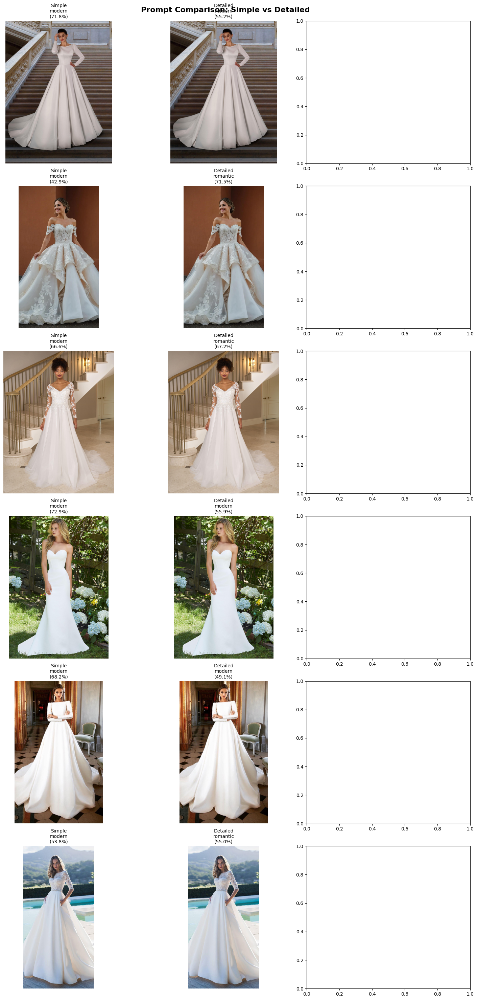

In [52]:
import matplotlib.pyplot as plt
from PIL import Image
import requests
from io import BytesIO

fig, axes = plt.subplots(6, 3, figsize=(15, 30))
fig.suptitle('Prompt Comparison: Simple vs Detailed', fontsize=16, fontweight='bold')

for idx in range(6):
    img_url = image_paths[idx]

    # Load image
    try:
        if img_url.startswith('http'):
            response = requests.get(img_url, timeout=10)
            img = Image.open(BytesIO(response.content))
        else:
            img = Image.open(img_url)
    except:
        continue

    # Show in all three columns
    for col, (preds, title) in enumerate([
        (dress_predictions_simple, 'Simple'),
        (dress_predictions_detailed, 'Detailed')
    ]):
        axes[idx, col].imshow(img)
        axes[idx, col].axis('off')
        pred = preds[idx]
        axes[idx, col].set_title(
            f"{title}\n{pred['predicted_label']}\n({pred['confidence']:.1%})",
            fontsize=10
        )

plt.tight_layout()
plt.show()

In [53]:
# Use the best performing prompts from Part 1
BEST_PROMPTS = best_strategy[1]  # predictions from best strategy
BEST_PROMPT_TYPE = best_strategy[0]

# Map to actual prompt definitions
if BEST_PROMPT_TYPE == "simple":
    chosen_prompts = simple_prompts
elif BEST_PROMPT_TYPE == "detailed":
    chosen_prompts = detailed_prompts
# Classify venues and shoes with best prompts

venue_predictions_best = batch_classify(venue_paths, labels=labels, descriptions=chosen_prompts)


#shoe_predictions_best = batch_classify(shoe_paths, labels=labels, descriptions=chosen_prompts)


dress_predictions_best = BEST_PROMPTS




venue_predictions_simple = batch_classify(venue_paths, labels=labels, descriptions=simple_prompts)
#shoe_predictions_simple = batch_classify(shoe_paths, labels=labels, descriptions=simple_prompts)


def compare_strategies_across_domains():
    """Compare simple vs best prompts across all domains"""

    print("Simple promt - All Domains")
    analyze_results(dress_predictions_simple, "Dresses (simple)")
    analyze_results(venue_predictions_simple, "Venues (simple)")
    #analyze_results(shoe_predictions_simple, "Shoes (simple)")

    print("Best prompt - All Domains")
    analyze_results(dress_predictions_best, f"Dresses ({BEST_PROMPT_TYPE})")
    analyze_results(venue_predictions_best, f"Venues ({BEST_PROMPT_TYPE})")
    #analyze_results(shoe_predictions_best, f"Shoes ({BEST_PROMPT_TYPE})")

compare_strategies_across_domains()

Simple promt - All Domains

Dresses (simple):
  Average confidence: 54.1%
  Label distribution:
    romantic      15 ( 15.0%)
    modern        73 ( 73.0%)
    dramatic      12 ( 12.0%)
    traditional    0 (  0.0%)

Venues (simple):
  Average confidence: 55.5%
  Label distribution:
    romantic      89 ( 89.0%)
    modern         7 (  7.0%)
    dramatic       4 (  4.0%)
    traditional    0 (  0.0%)
Best prompt - All Domains

Dresses (detailed):
  Average confidence: 68.9%
  Label distribution:
    romantic      69 ( 69.0%)
    modern        21 ( 21.0%)
    dramatic       6 (  6.0%)
    traditional    4 (  4.0%)

Venues (detailed):
  Average confidence: 54.9%
  Label distribution:
    romantic       0 (  0.0%)
    modern        15 ( 15.0%)
    dramatic      27 ( 27.0%)
    traditional   58 ( 58.0%)


In [54]:
import numpy as np

def confidence_drop_analysis(dress_simple, dress_best,
                             venue_simple, venue_best,
                             strategy_name):
    """Compare confidence drops between simple and refined prompts"""

    # Simple prompts
    dress_conf_simple = np.mean([p['confidence'] for p in dress_simple])
    venue_conf_simple = np.mean([p['confidence'] for p in venue_simple])
    #shoe_conf_simple = np.mean([p['confidence'] for p in shoe_simple])

    venue_drop_simple = (dress_conf_simple - venue_conf_simple) / dress_conf_simple * 100
    #shoe_drop_simple = (dress_conf_simple - shoe_conf_simple) / dress_conf_simple * 100

    # Best prompts
    dress_conf_best = np.mean([p['confidence'] for p in dress_best])
    venue_conf_best = np.mean([p['confidence'] for p in venue_best])
    #shoe_conf_best = np.mean([p['confidence'] for p in shoe_best])

    venue_drop_best = (dress_conf_best - venue_conf_best) / dress_conf_best * 100
    #shoe_drop_best = (dress_conf_best - shoe_conf_best) / dress_conf_best * 100

    print(f"\n Simple prompt:")
    print(f"  Dresses: {dress_conf_simple:.1%}")
    print(f"  Venues:  {venue_conf_simple:.1%} (drop: {venue_drop_simple:+.1f}%)")
    #print(f"  Shoes:   {shoe_conf_simple:.1%} (drop: {shoe_drop_simple:+.1f}%)")

    print(f"\n Best strategy prompt:")
    print(f"  Dresses: {dress_conf_best:.1%}")
    print(f"  Venues:  {venue_conf_best:.1%} (drop: {venue_drop_best:+.1f}%)")
    #print(f"  Shoes:   {shoe_conf_best:.1%} (drop: {shoe_drop_best:+.1f}%)")

    print(f"\n Improvement with best strategy prompt:")
    print(f"  Dresses: {(dress_conf_best - dress_conf_simple):.1%}")
    print(f"  Venues:  {(venue_conf_best - venue_conf_simple):.1%}")
    #print(f"  Shoes:   {(shoe_conf_best - shoe_conf_simple):.1%}")


confidence_drop_analysis(
    dress_predictions_simple, dress_predictions_best,
    venue_predictions_simple, venue_predictions_best,
    BEST_PROMPT_TYPE
)


 Simple prompt:
  Dresses: 54.1%
  Venues:  55.5% (drop: -2.6%)

 Best strategy prompt:
  Dresses: 68.9%
  Venues:  54.9% (drop: +20.4%)

 Improvement with best strategy prompt:
  Dresses: 14.8%
  Venues:  -0.6%


#Accuracy

In [55]:
from google.colab import drive
drive.mount('/content/drive')

data_path = "/content/drive/MyDrive/wedding_dresses"

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [56]:
import torch
import clip
from PIL import Image
from pathlib import Path
import numpy as np
from sklearn.metrics import classification_report, accuracy_score
from tqdm import tqdm

WEDDING_TEST_PATH = "/content/drive/MyDrive/wedding_dresses/test"
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

WEDDING_LABELS = ["romantic", "modern", "traditional", "dramatic"]

SIMPLE_PROMPTS = [
    "a photo of a romantic wedding dress",
    "a photo of a modern wedding dress",
    "a photo of a traditional wedding dress",
    "a photo of a dramatic wedding dress",
]

DETAILED_PROMPTS = [
    "a romantic wedding dress with soft flowing fabric, lace, and delicate details",
    "a modern wedding dress with clean lines, minimal embellishment, and contemporary style",
    "a traditional wedding dress with classic silhouette, modest neckline, and timeless design",
    "a dramatic wedding dress with bold statement details, voluminous skirt, or striking features",
]


model, preprocess = clip.load("ViT-B/32", device=DEVICE)
model.eval()

IMG_EXTS = {".jpg", ".jpeg", ".png", ".webp"}
paths, true_labels = [], []
for cls_dir in sorted(Path(WEDDING_TEST_PATH).iterdir()):
    if cls_dir.is_dir() and cls_dir.name in WEDDING_LABELS:
        for img_path in cls_dir.glob("*"):
            if img_path.suffix.lower() in IMG_EXTS:
                paths.append(img_path)
                true_labels.append(cls_dir.name)

print(f"Found {len(paths)} images | Classes: {sorted(set(true_labels))}")

def run_evaluation(prompts, prompt_name):
    text_tokens = clip.tokenize(prompts).to(DEVICE)
    with torch.no_grad():
        text_features = model.encode_text(text_tokens)
        text_features /= text_features.norm(dim=-1, keepdim=True)

    predictions, confidences = [], []
    for img_path in tqdm(paths, desc=f"Classifying ({prompt_name})"):
        try:
            image = preprocess(Image.open(img_path).convert("RGB")).unsqueeze(0).to(DEVICE)
            with torch.no_grad():
                image_features = model.encode_image(image)
                image_features /= image_features.norm(dim=-1, keepdim=True)
                probs = (image_features @ text_features.T * 100).softmax(dim=-1).cpu().numpy()[0]
            predictions.append(WEDDING_LABELS[probs.argmax()])
            confidences.append(probs.max())
        except Exception:
            predictions.append(None)
            confidences.append(None)

    valid = [(t, p, c) for t, p, c in zip(true_labels, predictions, confidences) if p is not None]
    true_v, pred_v, conf_v = zip(*valid)

    correct_mask = [t == p for t, p in zip(true_v, pred_v)]
    correct_conf = [c for c, m in zip(conf_v, correct_mask) if m]
    wrong_conf   = [c for c, m in zip(conf_v, correct_mask) if not m]

    print(f"ACCURACY — {prompt_name} prompts")
    print(f"Overall Accuracy:  {accuracy_score(true_v, pred_v):.1%}")


    print("\nPer-class breakdown:")
    print(classification_report(true_v, pred_v, labels=WEDDING_LABELS, zero_division=0))
    print(f"Mean confidence (all images):      {np.mean(conf_v):.1%}")
    print(f"Mean confidence (correct only):    {np.mean(correct_conf):.1%}")
    print(f"Mean confidence (incorrect only):  {np.mean(wrong_conf):.1%}")
    print("\nPer-class mean confidence:")
    for label in WEDDING_LABELS:
        class_conf = [c for t, c in zip(true_v, conf_v) if t == label]
        if class_conf:
            print(f"  {label:15s}: {np.mean(class_conf):.1%}")

run_evaluation(SIMPLE_PROMPTS, "Simple")
run_evaluation(DETAILED_PROMPTS, "Detailed")

100%|████████████████████████████████████████| 338M/338M [00:01<00:00, 189MiB/s]


Found 33 images | Classes: ['dramatic', 'modern', 'romantic', 'traditional']


Classifying (Simple): 100%|██████████| 33/33 [00:16<00:00,  2.01it/s]


ACCURACY — Simple prompts
Overall Accuracy:  33.3%

Per-class breakdown:
              precision    recall  f1-score   support

    romantic       0.50      0.33      0.40         9
      modern       0.30      0.70      0.42        10
 traditional       0.00      0.00      0.00         7
    dramatic       0.25      0.14      0.18         7

    accuracy                           0.33        33
   macro avg       0.26      0.29      0.25        33
weighted avg       0.28      0.33      0.28        33

Mean confidence (all images):      51.1%
Mean confidence (correct only):    55.4%
Mean confidence (incorrect only):  49.0%

Per-class mean confidence:
  romantic       : 50.1%
  modern         : 53.2%
  traditional    : 50.7%
  dramatic       : 49.9%


Classifying (Detailed): 100%|██████████| 33/33 [00:01<00:00, 20.72it/s]

ACCURACY — Detailed prompts
Overall Accuracy:  45.5%

Per-class breakdown:
              precision    recall  f1-score   support

    romantic       0.38      0.56      0.45         9
      modern       1.00      0.20      0.33        10
 traditional       0.50      0.71      0.59         7
    dramatic       0.38      0.43      0.40         7

    accuracy                           0.45        33
   macro avg       0.56      0.47      0.44        33
weighted avg       0.59      0.45      0.43        33

Mean confidence (all images):      57.6%
Mean confidence (correct only):    58.7%
Mean confidence (incorrect only):  56.7%

Per-class mean confidence:
  romantic       : 57.5%
  modern         : 56.1%
  traditional    : 53.4%
  dramatic       : 64.1%


#Different Dataset

In [57]:
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
TEST_PATH = "/content/drive/MyDrive/clothes/test"

LABELS = ["shirt", "t-shirt", "pants", "shoes", "shorts", "sneakers"]
PROMPTS = [
    "a photo of a shirt",
    "a photo of a t-shirt",
    "a photo of pants or trousers",
    "a photo of shoes or dress shoes",
    "a photo of shorts, short pants above the knee",
    "a photo of sneakers or athletic shoes",
]


model, preprocess = clip.load("ViT-B/32", device=DEVICE)
model.eval()

paths, true_labels = [], []
for cls_dir in sorted(Path(TEST_PATH).iterdir()):
    if cls_dir.is_dir() and cls_dir.name in LABELS:
        for img_path in cls_dir.glob("*"):
            if img_path.suffix.lower() in {".jpg", ".jpeg", ".png", ".webp"}:
                paths.append(img_path)
                true_labels.append(cls_dir.name)

print(f"Found {len(paths)} images | Classes: {sorted(set(true_labels))}")

Found 60 images | Classes: ['pants', 'shirt', 'shoes', 'shorts', 'sneakers', 't-shirt']


In [58]:
text_tokens = clip.tokenize(PROMPTS).to(DEVICE)
with torch.no_grad():
    text_features = model.encode_text(text_tokens)
    text_features /= text_features.norm(dim=-1, keepdim=True)

predictions, confidences = [], []
for img_path in tqdm(paths, desc="Classifying"):
    try:
        image = preprocess(Image.open(img_path).convert("RGB")).unsqueeze(0).to(DEVICE)
        with torch.no_grad():
            image_features = model.encode_image(image)
            image_features /= image_features.norm(dim=-1, keepdim=True)
            probs = (image_features @ text_features.T * 100).softmax(dim=-1).cpu().numpy()[0]
        predictions.append(LABELS[probs.argmax()])
        confidences.append(probs.max())
    except Exception:
        predictions.append(None)
        confidences.append(None)

valid = [(t, p, c) for t, p, c in zip(true_labels, predictions, confidences) if p is not None]
true_v, pred_v, conf_v = zip(*valid)


print("ACCURACY — labels vs CLIP predictions")

print(f"Overall Accuracy: {accuracy_score(true_v, pred_v):.1%}")
print("\nPer-class breakdown:")
print(classification_report(true_v, pred_v, labels=LABELS, zero_division=0))
print(f"\nMean confidence (all):       {np.mean(conf_v):.1%}")
print(f"Mean confidence (correct):   {np.mean([c for t,p,c in zip(true_v,pred_v,conf_v) if t==p]):.1%}")
print(f"Mean confidence (incorrect): {np.mean([c for t,p,c in zip(true_v,pred_v,conf_v) if t!=p]):.1%}")

Classifying: 100%|██████████| 60/60 [00:26<00:00,  2.29it/s]

ACCURACY — labels vs CLIP predictions
Overall Accuracy: 96.7%

Per-class breakdown:
              precision    recall  f1-score   support

       shirt       0.83      1.00      0.91        10
     t-shirt       1.00      0.80      0.89        10
       pants       1.00      1.00      1.00        10
       shoes       1.00      1.00      1.00        10
      shorts       1.00      1.00      1.00        10
    sneakers       1.00      1.00      1.00        10

    accuracy                           0.97        60
   macro avg       0.97      0.97      0.97        60
weighted avg       0.97      0.97      0.97        60


Mean confidence (all):       86.4%
Mean confidence (correct):   87.5%
Mean confidence (incorrect): 55.8%


In [59]:
PROMPTS = [
    "a dress shirt with a collar, buttons, and long or short sleeves, typically worn formally",
    "a casual t-shirt with short sleeves, round or v-neck, no collar or buttons",
    "a pair of long pants or trousers covering the full leg, with a waistband",
    "a pair of formal or casual shoes, closed toe, made of leather or synthetic material",
    "a pair of shorts with legs ending above the knee, casual wear",
    "a pair of sneakers or athletic shoes with rubber sole, designed for sport or casual wear",
]

In [60]:
text_tokens = clip.tokenize(PROMPTS).to(DEVICE)
with torch.no_grad():
    text_features = model.encode_text(text_tokens)
    text_features /= text_features.norm(dim=-1, keepdim=True)

predictions, confidences = [], []
for img_path in tqdm(paths, desc="Classifying"):
    try:
        image = preprocess(Image.open(img_path).convert("RGB")).unsqueeze(0).to(DEVICE)
        with torch.no_grad():
            image_features = model.encode_image(image)
            image_features /= image_features.norm(dim=-1, keepdim=True)
            probs = (image_features @ text_features.T * 100).softmax(dim=-1).cpu().numpy()[0]
        predictions.append(LABELS[probs.argmax()])
        confidences.append(probs.max())
    except Exception:
        predictions.append(None)
        confidences.append(None)

valid = [(t, p, c) for t, p, c in zip(true_labels, predictions, confidences) if p is not None]
true_v, pred_v, conf_v = zip(*valid)


print("ACCURACY — labels vs CLIP predictions")

print(f"Overall Accuracy: {accuracy_score(true_v, pred_v):.1%}")
print("\nPer-class breakdown:")
print(classification_report(true_v, pred_v, labels=LABELS, zero_division=0))
print(f"\nMean confidence (all):       {np.mean(conf_v):.1%}")
print(f"Mean confidence (correct):   {np.mean([c for t,p,c in zip(true_v,pred_v,conf_v) if t==p]):.1%}")
print(f"Mean confidence (incorrect): {np.mean([c for t,p,c in zip(true_v,pred_v,conf_v) if t!=p]):.1%}")

Classifying: 100%|██████████| 60/60 [00:02<00:00, 27.15it/s]

ACCURACY — labels vs CLIP predictions
Overall Accuracy: 90.0%

Per-class breakdown:
              precision    recall  f1-score   support

       shirt       1.00      0.40      0.57        10
     t-shirt       0.62      1.00      0.77        10
       pants       1.00      1.00      1.00        10
       shoes       1.00      1.00      1.00        10
      shorts       1.00      1.00      1.00        10
    sneakers       1.00      1.00      1.00        10

    accuracy                           0.90        60
   macro avg       0.94      0.90      0.89        60
weighted avg       0.94      0.90      0.89        60


Mean confidence (all):       91.7%
Mean confidence (correct):   92.7%
Mean confidence (incorrect): 83.7%


In [61]:
TEST_PATH = "/content/drive/MyDrive/clothes/test"

CLOTHES_LABELS = ["shirt", "t-shirt", "pants", "shoes", "shorts", "sneakers"]
AESTHETIC_LABELS = ["minimalist", "streetwear", "elegant", "sporty"]
AESTHETIC_PROMPTS = [
    "a minimalist, clean and simple clothing item with no decoration",
    "a streetwear clothing item, urban and casual with an edgy style",
    "an elegant, refined and sophisticated clothing item",
    "a sporty athletic clothing item for physical activity",
]

model, preprocess = clip.load("ViT-B/32", device=DEVICE)
model.eval()

IMG_EXTS = {".jpg", ".jpeg", ".png", ".webp"}
paths, true_labels = [], []
for cls_dir in sorted(Path(TEST_PATH).iterdir()):
    if cls_dir.is_dir() and cls_dir.name in CLOTHES_LABELS:
        for img_path in cls_dir.glob("*"):
            if img_path.suffix.lower() in IMG_EXTS:
                paths.append(img_path)
                true_labels.append(cls_dir.name)

print(f"Found {len(paths)} images | Classes: {sorted(set(true_labels))}")

text_tokens = clip.tokenize(AESTHETIC_PROMPTS).to(DEVICE)
with torch.no_grad():
    text_features = model.encode_text(text_tokens)
    text_features /= text_features.norm(dim=-1, keepdim=True)

predictions, confidences = [], []
for img_path in tqdm(paths, desc="Classifying"):
    try:
        image = preprocess(Image.open(img_path).convert("RGB")).unsqueeze(0).to(DEVICE)
        with torch.no_grad():
            image_features = model.encode_image(image)
            image_features /= image_features.norm(dim=-1, keepdim=True)
            probs = (image_features @ text_features.T * 100).softmax(dim=-1).cpu().numpy()[0]
        predictions.append(AESTHETIC_LABELS[probs.argmax()])
        confidences.append(probs.max())
    except Exception:
        predictions.append(None)
        confidences.append(None)

Found 60 images | Classes: ['pants', 'shirt', 'shoes', 'shorts', 'sneakers', 't-shirt']


Classifying: 100%|██████████| 60/60 [00:01<00:00, 39.11it/s]


In [62]:
from collections import Counter

# --- DISTRIBUTION PER TRUE CLOTHES LABEL ---
print("\nAESTHETIC DISTRIBUTION PER CLOTHES CATEGORY:")


for clothes_class in CLOTHES_LABELS:
    indices = [i for i, t in enumerate(true_labels) if t == clothes_class and predictions[i] is not None]
    class_preds = [predictions[i] for i in indices]
    dist = Counter(class_preds)
    print(f"\n  {clothes_class.upper()} ({len(indices)} images):")
    for label in AESTHETIC_LABELS:
        count = dist.get(label, 0)
        bar = "█" * int(count / len(indices) * 20) if indices else ""
        print(f"    {label:15s}: {count:3d} ({count/len(indices)*100:.1f}%) {bar}")


AESTHETIC DISTRIBUTION PER CLOTHES CATEGORY:

  SHIRT (10 images):
    minimalist     :   0 (0.0%) 
    streetwear     :   2 (20.0%) ████
    elegant        :   7 (70.0%) ██████████████
    sporty         :   1 (10.0%) ██

  T-SHIRT (10 images):
    minimalist     :   2 (20.0%) ████
    streetwear     :   3 (30.0%) ██████
    elegant        :   4 (40.0%) ████████
    sporty         :   1 (10.0%) ██

  PANTS (10 images):
    minimalist     :   0 (0.0%) 
    streetwear     :   4 (40.0%) ████████
    elegant        :   3 (30.0%) ██████
    sporty         :   3 (30.0%) ██████

  SHOES (10 images):
    minimalist     :   0 (0.0%) 
    streetwear     :   0 (0.0%) 
    elegant        :  10 (100.0%) ████████████████████
    sporty         :   0 (0.0%) 

  SHORTS (10 images):
    minimalist     :   0 (0.0%) 
    streetwear     :   4 (40.0%) ████████
    elegant        :   0 (0.0%) 
    sporty         :   6 (60.0%) ████████████

  SNEAKERS (10 images):
    minimalist     :   0 (0.0%) 
    stree

In [63]:
from collections import Counter

# --- OVERALL DISTRIBUTION ---
valid_preds = [p for p in predictions if p is not None]
valid_conf = [c for c in confidences if c is not None]
dist = Counter(valid_preds)

print("\n\nOVERALL AESTHETIC DISTRIBUTION:")
for label in AESTHETIC_LABELS:
    bar = "█" * int(dist[label] / len(valid_preds) * 40)
    print(f"  {label:15s}: {dist[label]:4d} ({dist[label]/len(valid_preds)*100:.1f}%) {bar}")

# --- CONFIDENCE ---
print("\n\nCONFIDENCE COMPARISON:")
print(f"  Mean confidence (aesthetic on clothes): {np.mean(valid_conf):.1%}")
print(f"  Mean confidence (correct on clothes):   86.0%  (from basic clothes task)")
print(f"  Mean confidence (aesthetic on dresses): 57.6%  (from wedding task)")



OVERALL AESTHETIC DISTRIBUTION:
  minimalist     :    2 (3.3%) █
  streetwear     :   15 (25.0%) ██████████
  elegant        :   24 (40.0%) ████████████████
  sporty         :   19 (31.7%) ████████████


CONFIDENCE COMPARISON:
  Mean confidence (aesthetic on clothes): 66.9%
  Mean confidence (correct on clothes):   86.0%  (from basic clothes task)
  Mean confidence (aesthetic on dresses): 57.6%  (from wedding task)


#Fun Viz

In [64]:
import numpy as np
import torch
from PIL import Image
import requests
from io import BytesIO
import matplotlib.pyplot as plt
import clip # Ensure clip is imported for tokenize and preprocess

def _load_pil(path):
    if isinstance(path, str) and path.startswith("http"):
        r = requests.get(path, timeout=15)
        r.raise_for_status()
        return Image.open(BytesIO(r.content)).convert("RGB")
    return Image.open(path).convert("RGB")

@torch.no_grad()
def get_image_embeddings(paths, batch_size=16, desc="Embedding images"):
    embs = []
    for i in range(0, len(paths), batch_size):
        batch = paths[i:i+batch_size]
        # Preprocess images using the 'preprocess' function from openai/CLIP
        processed_images = torch.stack([preprocess(_load_pil(p)) for p in batch]).to(device)
        feats = model.encode_image(processed_images)
        feats = feats / feats.norm(dim=-1, keepdim=True)
        embs.append(feats.detach().cpu().numpy())
    return np.vstack(embs)

@torch.no_grad()
def get_text_embeddings(texts):
    # Use clip.tokenize from openai/CLIP library
    text_tokens = clip.tokenize(texts).to(device)
    feats = model.encode_text(text_tokens)
    feats = feats / feats.norm(dim=-1, keepdim=True)
    return feats.detach().cpu().numpy()

def cosine_sim_matrix(A, B):
    # A: (N,D), B:(M,D) normalized => cosine = dot
    return A @ B.T

def show_image_grid(paths, titles=None, n_cols=5, figsize=(14, 10)):
    n = len(paths)
    n_rows = (n + n_cols - 1) // n_cols
    fig, axes = plt.subplots(n_rows, n_cols, figsize=figsize)
    axes = np.array(axes).reshape(-1)

    for i in range(len(axes)):
        axes[i].axis("off")

    for i, p in enumerate(paths):
        img = _load_pil(p)
        axes[i].imshow(img)
        axes[i].axis("off")
        if titles is not None:
            axes[i].set_title(titles[i], fontsize=9)

    plt.tight_layout()
    plt.show()

In [65]:
# Pick which domains you actually have loaded in the notebook
DOMAINS = []
if "image_paths" in globals():
    DOMAINS.append(("dresses", image_paths))
if "venue_paths" in globals():
    DOMAINS.append(("venues", venue_paths))
if "shoe_paths" in globals():
    DOMAINS.append(("shoes", shoe_paths))

domain_embs = {}
for name, paths in DOMAINS:
    print(f"Embedding {name}: {len(paths)} images")
    domain_embs[name] = get_image_embeddings(paths, batch_size=16)

# Prompts: match what you used in batch_classify
# If you used descriptions=None, prompts were "a photo of a {label} wedding dress"
default_prompts = [f"a photo of a {lab} wedding dress" for lab in labels]
text_emb_default = get_text_embeddings(default_prompts)

# Optional: if you have detailed_prompts defined
text_emb_detailed = None
if "detailed_prompts" in globals() and detailed_prompts is not None:
    text_emb_detailed = get_text_embeddings(detailed_prompts)

print("Done. Available:", list(domain_embs.keys()))

Embedding dresses: 100 images
Embedding venues: 100 images
Embedding shoes: 100 images
Done. Available: ['dresses', 'venues', 'shoes']


In [66]:
import numpy as np
import pandas as pd

def build_pred_df(paths, predictions, domain_name):
    # predictions: dict[path] -> {'predicted_label': str, 'confidence': float, 'probabilities': {label: prob}}
    rows = []
    for p in paths:
        d = predictions[p]
        rows.append({
            "path": p,
            "domain": domain_name,
            "pred": d["predicted_label"],
            "conf": float(d["confidence"]),
        })
    return pd.DataFrame(rows)

def attach_geometry(df, X_img, text_emb, labels):
    # text_emb aligned with labels
    label_to_i = {lab:i for i, lab in enumerate(labels)}

    # similarity to predicted text vector
    pred_i = df["pred"].map(label_to_i).values
    pred_vec = text_emb[pred_i]  # (N,D)
    sim_pred = np.sum(X_img * pred_vec, axis=1)          # cosine sim
    dist_pred = 1 - sim_pred                             # smaller = closer

    # margin: top1 sim - top2 sim (geometry-based confidence-ish)
    S = X_img @ text_emb.T                               # (N,C)
    top2 = np.partition(S, -2, axis=1)[:, -2:]
    top1 = top2[:, 1]
    top2v = top2[:, 0]
    margin = top1 - top2v

    df = df.copy()
    df["sim_pred_text"] = sim_pred
    df["dist_pred_text"] = dist_pred
    df["margin_geom"] = margin
    return df

In [67]:
from collections import defaultdict
import pandas as pd # Ensure pandas is imported
import numpy as np # Ensure numpy is imported

def build_pred_df(predictions, domain_name):
    # predictions: list of dicts, where each dict has 'image_path', 'predicted_label', 'confidence'
    rows = []
    for d in predictions:
        rows.append({
            "path": d["image_path"],
            "domain": domain_name,
            "pred": d["predicted_label"],
            "conf": float(d["confidence"]),
        })
    return pd.DataFrame(rows)

def attach_geometry(df, X_img, text_emb, labels):
    # text_emb aligned with labels
    label_to_i = {lab:i for i, lab in enumerate(labels)}

    # similarity to predicted text vector
    pred_i = df["pred"].map(label_to_i).values
    pred_vec = text_emb[pred_i]  # (N,D)
    sim_pred = np.sum(X_img * pred_vec, axis=1)          # cosine sim
    dist_pred = 1 - sim_pred                             # smaller = closer

    # margin: top1 sim - top2 sim (geometry-based confidence-ish)
    S = X_img @ text_emb.T                               # (N,C)
    top2 = np.partition(S, -2, axis=1)[:, -2:]
    top1 = top2[:, 1]
    top2v = top2[:, 0]
    margin = top1 - top2v

    df = df.copy()
    df["sim_pred_text"] = sim_pred.astype(np.float32)
    df["dist_pred_text"] = dist_pred.astype(np.float32)
    df["margin_geom"] = margin.astype(np.float32)
    return df

def class_cohesion_overlap(X_img, pred_labels, text_emb, labels):
    # Use predicted labels (works even if you don't have GT)
    label_to_i = {lab:i for i, lab in enumerate(labels)}
    pred_i = np.array([label_to_i[l] for l in pred_labels])

    # Cohesion: avg distance to class centroid in image space
    centroids = np.zeros((len(labels), X_img.shape[1]))
    for c in range(len(labels)):
        idx = np.where(pred_i == c)[0]
        if len(idx) == 0:
            centroids[c] = np.nan
            continue
        mu = X_img[idx].mean(axis=0)
        mu = mu / np.linalg.norm(mu)
        centroids[c] = mu

    cohesion = {}
    for c, lab in enumerate(labels):
        idx = np.where(pred_i == c)[0]
        if len(idx) < 2:
            cohesion[lab] = np.nan
            continue
        d = 1 - (X_img[idx] @ centroids[c])  # dist to centroid
        cohesion[lab] = float(np.mean(d))

    # Overlap: how often points assigned to lab have close runner-up sims to other labels
    S = X_img @ text_emb.T
    # For each point, compare best vs second best similarity
    sortedS = np.sort(S, axis=1)
    margin = sortedS[:,-1] - sortedS[:,-2]
    overlap = {}
    for c, lab in enumerate(labels):
        idx = np.where(pred_i == c)[0]
        overlap[lab] = float(np.mean(margin[idx])) if len(idx) else np.nan

    # Higher cohesion value = worse cluster (more spread)
    # Lower overlap margin = more confusion/overlap with other classes
    out = pd.DataFrame({
        "label": labels,
        "avg_dist_to_centroid (higher=worse)": [cohesion[l] for l in labels],
        "avg_top1-top2_margin (lower=more overlap)": [overlap[l] for l in labels],
    }).sort_values("avg_dist_to_centroid (higher=worse)", ascending=False)

    return out

# Example for dresses domain using your SIMPLE predictions dict:
dname = "dresses"
X = domain_embs[dname]
df_pred = build_pred_df(dress_predictions_simple, dname)
stats = class_cohesion_overlap(X, df_pred["pred"].tolist(), text_emb_default, labels)
stats

,label,avg_dist_to_centroid (higher=worse),avg_top1-top2_margin (lower=more overlap)
1,modern,0.093874,0.007614
2,dramatic,0.089324,0.004070
0,romantic,0.053136,0.002312
3,traditional,NaN,NaN


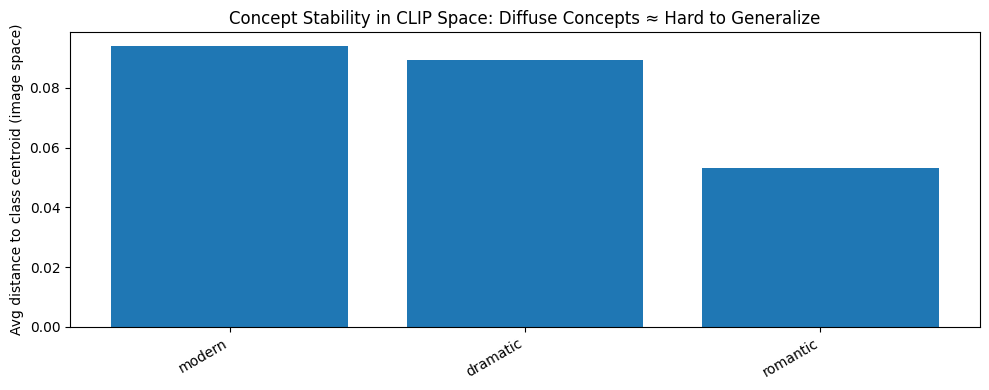

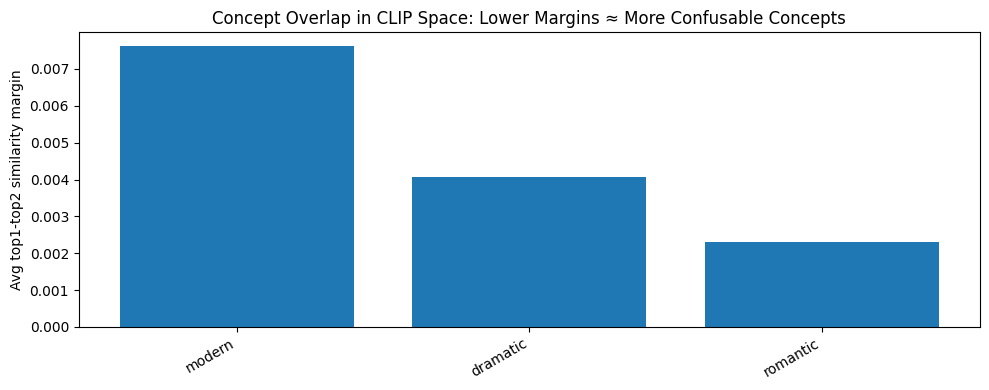

In [68]:
import matplotlib.pyplot as plt

plot_df = stats.dropna()

plt.figure(figsize=(10,4))
plt.bar(plot_df["label"], plot_df["avg_dist_to_centroid (higher=worse)"])
plt.xticks(rotation=30, ha="right")
plt.ylabel("Avg distance to class centroid (image space)")
plt.title("Concept Stability in CLIP Space: Diffuse Concepts ≈ Hard to Generalize")
plt.tight_layout()
plt.show()

plt.figure(figsize=(10,4))
plt.bar(plot_df["label"], plot_df["avg_top1-top2_margin (lower=more overlap)"])
plt.xticks(rotation=30, ha="right")
plt.ylabel("Avg top1-top2 similarity margin")
plt.title("Concept Overlap in CLIP Space: Lower Margins ≈ More Confusable Concepts")
plt.tight_layout()
plt.show()

In [69]:
def domain_centroid_drift(domain_embs):
    domains = list(domain_embs.keys())
    centroids = {}
    for d in domains:
        mu = domain_embs[d].mean(axis=0)
        mu = mu / np.linalg.norm(mu)
        centroids[d] = mu

    # cosine distance matrix between domain centroids
    D = pd.DataFrame(index=domains, columns=domains, dtype=float)
    for a in domains:
        for b in domains:
            D.loc[a,b] = float(1 - (centroids[a] @ centroids[b]))
    return D

drift = domain_centroid_drift(domain_embs)
drift

,dresses,venues,shoes
dresses,0.000000,0.220703,0.153320
venues,0.220703,-0.000977,0.260254
shoes,0.153320,0.260254,0.000000


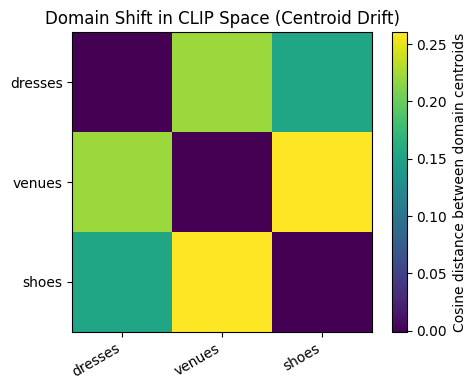

In [70]:
import matplotlib.pyplot as plt

plt.figure(figsize=(5,4))
plt.imshow(drift.values)
plt.xticks(range(len(drift.columns)), drift.columns, rotation=30, ha="right")
plt.yticks(range(len(drift.index)), drift.index)
plt.colorbar(label="Cosine distance between domain centroids")
plt.title("Domain Shift in CLIP Space (Centroid Drift)")
plt.tight_layout()
plt.show()

In [71]:
# Requires you have detailed_prompts + text_emb_detailed
assert text_emb_detailed is not None, "Run embeddings for detailed prompts first."

# Compare how far each label prompt moves in embedding space
moves = 1 - np.sum(text_emb_default * text_emb_detailed, axis=1)  # cosine distance
move_df = pd.DataFrame({"label": labels, "prompt_shift_dist": moves}).sort_values("prompt_shift_dist", ascending=False)
move_df

,label,prompt_shift_dist
3,traditional,0.301270
0,romantic,0.258301
2,dramatic,0.253906
1,modern,0.239746


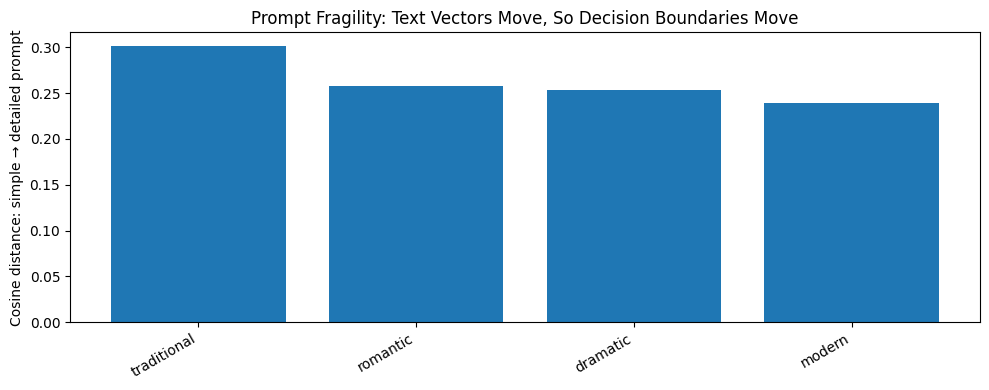

In [72]:
plt.figure(figsize=(10,4))
plt.bar(move_df["label"], move_df["prompt_shift_dist"])
plt.xticks(rotation=30, ha="right")
plt.ylabel("Cosine distance: simple → detailed prompt")
plt.title("Prompt Fragility: Text Vectors Move, So Decision Boundaries Move")
plt.tight_layout()
plt.show()

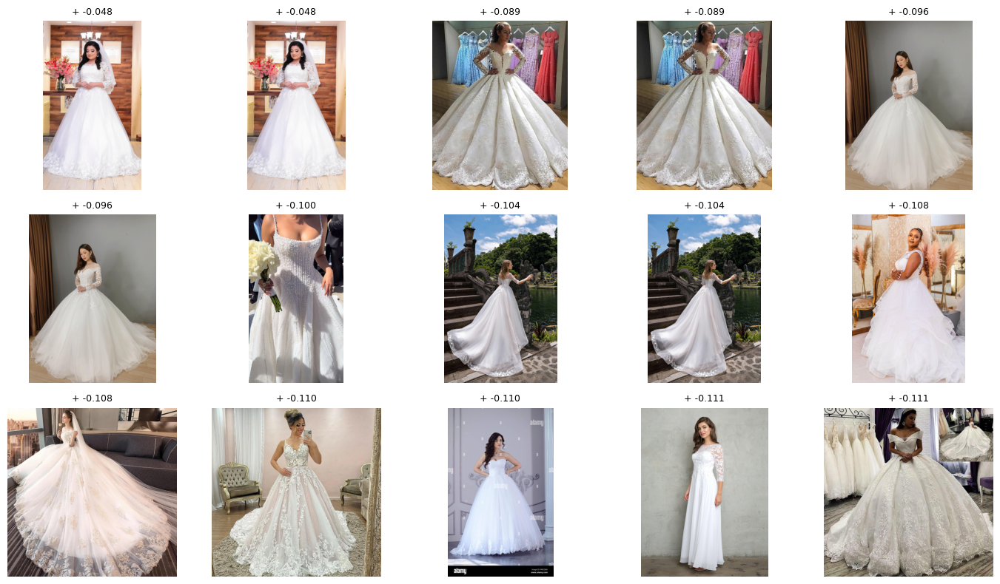

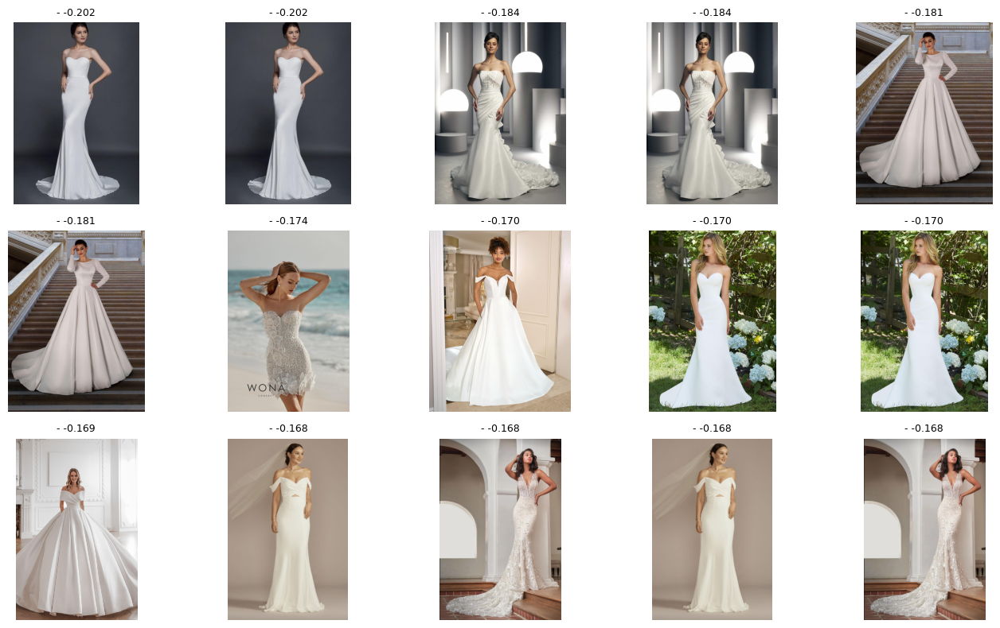

In [73]:
label_to_i = {lab:i for i, lab in enumerate(labels)}

def semantic_lens_rank(paths, X_img, text_emb, pos_label, neg_label, top_k=20):
    v = text_emb[label_to_i[pos_label]] - text_emb[label_to_i[neg_label]]
    v = v / np.linalg.norm(v)

    scores = X_img @ v  # projection
    top = np.argsort(-scores)[:top_k]
    bot = np.argsort(scores)[:top_k]

    return (top, scores[top]), (bot, scores[bot])

# Example: traditional vs modern on dresses
(pos_idx, pos_scores), (neg_idx, neg_scores) = semantic_lens_rank(
    image_paths, domain_embs["dresses"], text_emb_default,
    pos_label="traditional", neg_label="modern", top_k=15
)

show_image_grid([image_paths[i] for i in pos_idx],
                titles=[f"+ {pos_scores[j]:.3f}" for j in range(len(pos_idx))],
                n_cols=5, figsize=(14,8))

show_image_grid([image_paths[i] for i in neg_idx],
                titles=[f"- {neg_scores[j]:.3f}" for j in range(len(neg_idx))],
                n_cols=5, figsize=(14,8))

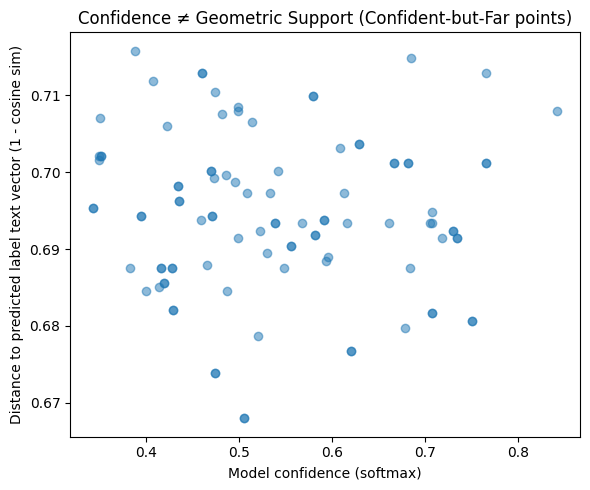

,conf,pred,dist_pred_text,margin_geom,path
58,0.841267,modern,0.708008,0.020752,wedding_dresses/image_058.jpg
10,0.765441,modern,0.701172,0.017334,wedding_dresses/image_010.jpg
79,0.765441,modern,0.701172,0.017334,wedding_dresses/image_079.jpg
56,0.764998,modern,0.712891,0.017090,wedding_dresses/image_056.jpg
19,0.749641,modern,0.680664,0.013916,wedding_dresses/image_019.jpg
88,0.749641,modern,0.680664,0.013916,wedding_dresses/image_088.jpg
98,0.734451,modern,0.691406,0.013184,wedding_dresses/image_098.jpg
29,0.734450,modern,0.691406,0.013184,wedding_dresses/image_029.jpg
3,0.729330,modern,0.692383,0.011963,wedding_dresses/image_003.jpg
72,0.729330,modern,0.692383,0.011963,wedding_dresses/image_072.jpg


In [74]:
import matplotlib.pyplot as plt

# Build df for dresses and attach geometry relative to SIMPLE prompts
df_d = build_pred_df(dress_predictions_simple, "dresses")
df_d = attach_geometry(df_d, domain_embs["dresses"], text_emb_default, labels)

plt.figure(figsize=(6,5))
plt.scatter(df_d["conf"], df_d["dist_pred_text"], alpha=0.5)
plt.xlabel("Model confidence (softmax)")
plt.ylabel("Distance to predicted label text vector (1 - cosine sim)")
plt.title("Confidence ≠ Geometric Support (Confident-but-Far points)")
plt.tight_layout()
plt.show()

# Show the most suspicious examples: high confidence, far distance
susp = df_d.sort_values(["conf","dist_pred_text"], ascending=[False, False]).head(15)
susp[["conf","pred","dist_pred_text","margin_geom","path"]]

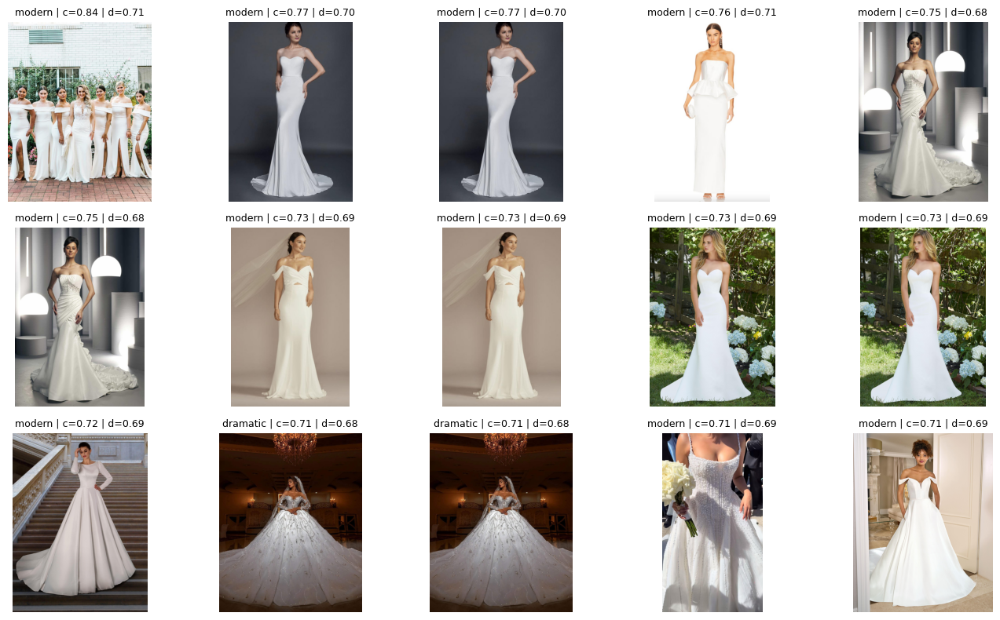

In [75]:
show_image_grid(susp["path"].tolist(),
                titles=[f"{p} | c={c:.2f} | d={d:.2f}" for p,c,d in zip(susp["pred"], susp["conf"], susp["dist_pred_text"])],
                n_cols=5, figsize=(14,8))

Flip rate: 0.61


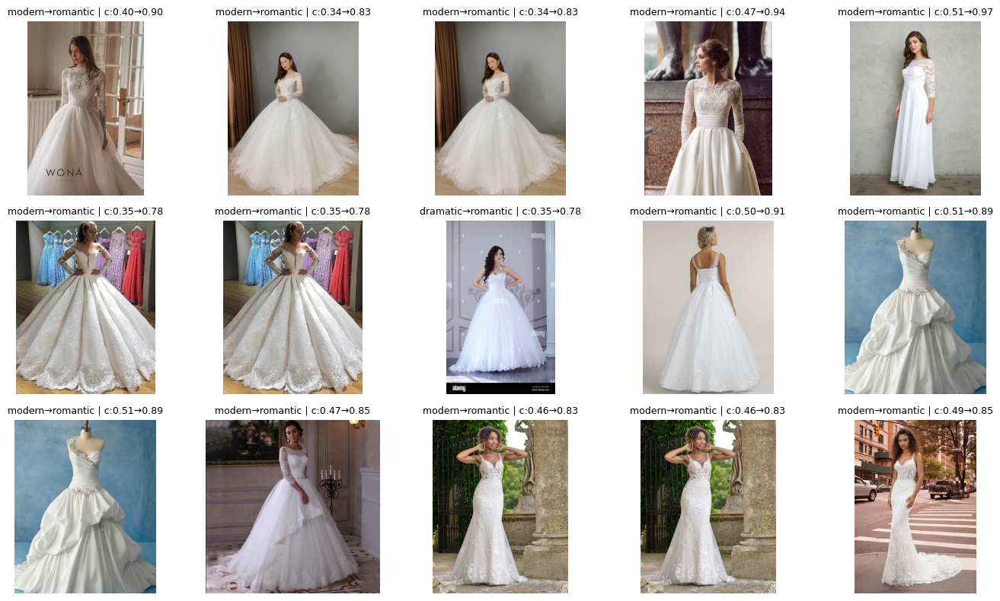

In [76]:
# You need dress_predictions_simple and dress_predictions_detailed from your notebook
assert "dress_predictions_detailed" in globals(), "You need predictions with detailed prompts."

df_s = build_pred_df(dress_predictions_simple, "dresses")
df_t = build_pred_df(dress_predictions_detailed, "dresses")

flip = df_s.merge(df_t, on=["path","domain"], suffixes=("_simple","_detailed"))
flip["flipped"] = flip["pred_simple"] != flip["pred_detailed"]
flip_rate = flip["flipped"].mean()
print("Flip rate:", flip_rate)

# Show top confidence flips (fun + shocking)
flip_sorted = flip[flip["flipped"]].copy()
flip_sorted["conf_gap"] = (flip_sorted["conf_detailed"] - flip_sorted["conf_simple"]).abs()
flip_sorted = flip_sorted.sort_values(["conf_gap"], ascending=False).head(15)

show_image_grid(
    flip_sorted["path"].tolist(),
    titles=[f"{a}→{b} | c:{cs:.2f}→{cd:.2f}"
            for a,b,cs,cd in zip(flip_sorted["pred_simple"], flip_sorted["pred_detailed"],
                                 flip_sorted["conf_simple"], flip_sorted["conf_detailed"])],
    n_cols=5, figsize=(14,8)
)

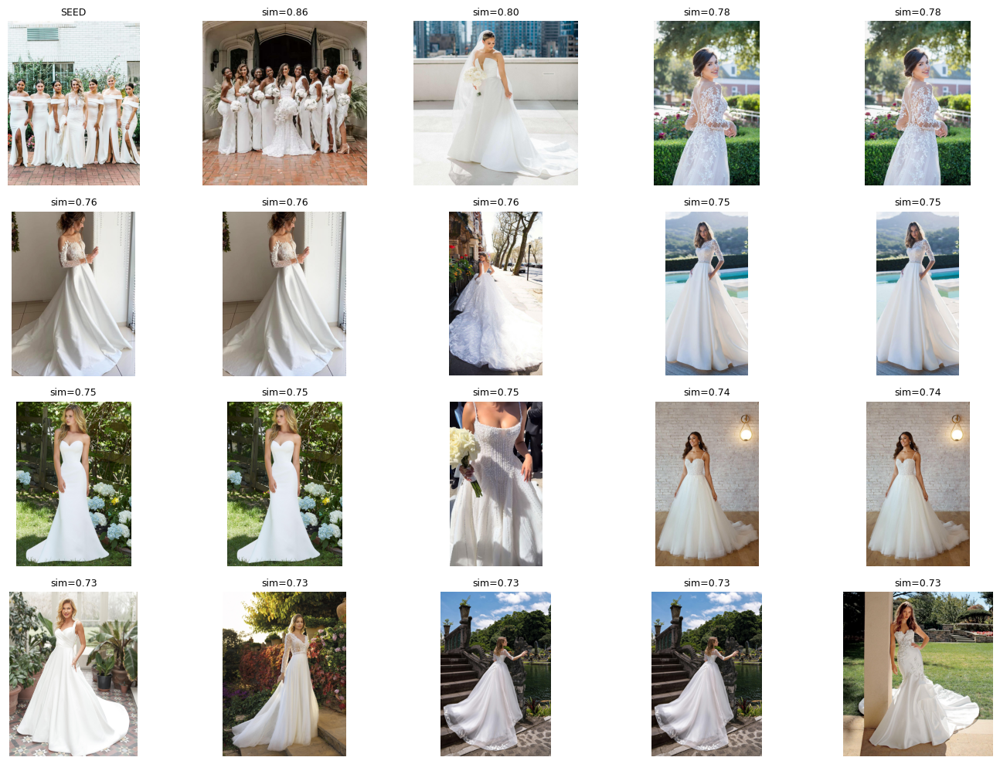

In [77]:
def nearest_neighbors(paths, X_img, seed_idx, k=20):
    S = X_img @ X_img.T
    np.fill_diagonal(S, -1)
    nn = np.argsort(-S[seed_idx])[:k]
    return nn, S[seed_idx, nn]

# choose a seed that model calls "modern" with high confidence
cand = df_d[df_d["pred"]=="modern"].sort_values("conf", ascending=False).head(1)
seed_path = cand["path"].iloc[0]
seed_idx = image_paths.index(seed_path)

nn, sims = nearest_neighbors(image_paths, domain_embs["dresses"], seed_idx, k=20)

show_image_grid(
    [image_paths[seed_idx]] + [image_paths[i] for i in nn[:19]],
    titles=["SEED"] + [f"sim={s:.2f}" for s in sims[:19]],
    n_cols=5, figsize=(14,10)
)

In [78]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Try UMAP; fall back to PCA
use_umap = True
try:
    import umap
except Exception:
    use_umap = False
    from sklearn.decomposition import PCA

def reduce_2d(X, method="umap"):
    if method == "umap" and use_umap:
        reducer = umap.UMAP(n_neighbors=35, min_dist=0.08, metric="cosine", random_state=42)
        return reducer.fit_transform(X)
    else:
        return PCA(n_components=2, random_state=42).fit_transform(X)

# ---- collect domains you have
DOMAINS = []
if "image_paths" in globals(): DOMAINS.append(("dresses", image_paths))
if "venue_paths" in globals(): DOMAINS.append(("venues", venue_paths))
if "shoe_paths" in globals(): DOMAINS.append(("shoes", shoe_paths))

# ---- image embeddings already computed as domain_embs[domain]
# ---- text embeddings: use your actual prompt set; default matches your notebook's style
default_prompts = [f"a photo of a {lab} wedding dress" for lab in labels]
text_emb = get_text_embeddings(default_prompts)

# Merge image embs into one matrix
all_img = []
all_meta = []
for dname, paths in DOMAINS:
    X = domain_embs[dname]
    all_img.append(X)
    all_meta += [{"kind":"image","domain":dname,"path":p} for p in paths]
all_img = np.vstack(all_img)

# Merge with text embs so prompts are co-embedded in same reducer fit
X_all = np.vstack([all_img, text_emb])
XY = reduce_2d(X_all, method="umap" if use_umap else "pca")

XY_img = XY[:len(all_img)]
XY_txt = XY[len(all_img):]

df_img = pd.DataFrame({
    "x": XY_img[:,0], "y": XY_img[:,1],
    "domain": [m["domain"] for m in all_meta],
    "path": [m["path"] for m in all_meta],
})
df_txt = pd.DataFrame({
    "x": XY_txt[:,0], "y": XY_txt[:,1],
    "label": labels,
    "prompt": default_prompts
})

print("Reduced:", "UMAP" if use_umap else "PCA", "| images:", len(df_img), "| prompts:", len(df_txt))

Reduced: UMAP | images: 300 | prompts: 4


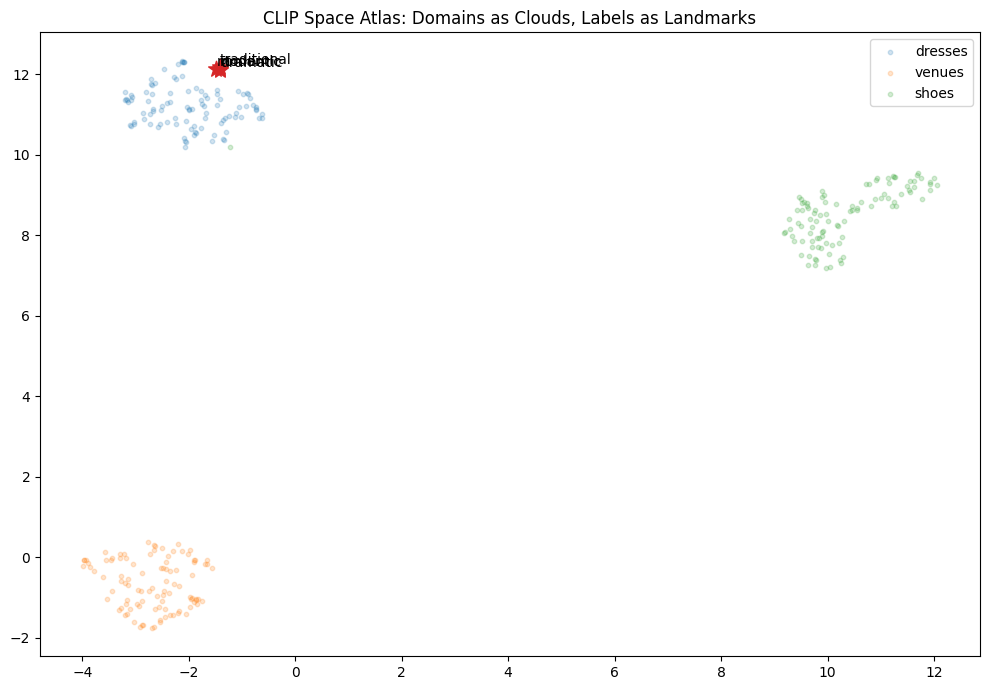

In [79]:
plt.figure(figsize=(10,7))

# images (faint)
for d in df_img["domain"].unique():
    sub = df_img[df_img["domain"]==d]
    plt.scatter(sub["x"], sub["y"], s=10, alpha=0.20, label=d)

# prompts (big + labeled)
plt.scatter(df_txt["x"], df_txt["y"], s=140, marker="*", linewidths=1)
for _, r in df_txt.iterrows():
    plt.text(r["x"], r["y"], r["label"], fontsize=10, ha="left", va="bottom")

plt.title("CLIP Space Atlas: Domains as Clouds, Labels as Landmarks")
plt.legend()
plt.tight_layout()
plt.show()

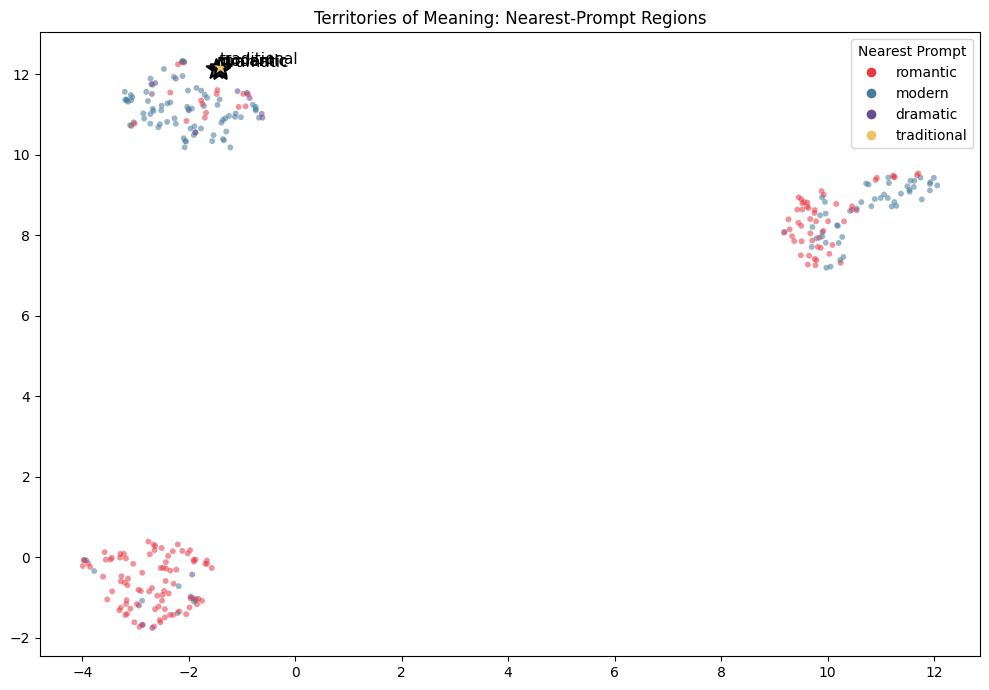

In [80]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.lines import Line2D

# Territory assignment in ORIGINAL space (more faithful)
S = all_img @ text_emb.T  # cosine similarity since both normalized
assign = np.argmax(S, axis=1)  # nearest label prompt

# ---- Define a categorical color palette (edit if you like)
palette = {
    "romantic": "#E63946",     # soft red
    "modern": "#457B9D",       # blue
    "dramatic": "#6A4C93",     # purple
    "traditional": "#E9C46A"   # gold
}

# Ensure label order matches text_emb
label_to_color = {lab: palette[lab] for lab in labels}

# Map each assigned index to its label color
point_colors = [label_to_color[labels[i]] for i in assign]

plt.figure(figsize=(10,7))

# Plot image points
plt.scatter(
    df_img["x"],
    df_img["y"],
    c=point_colors,
    s=18,
    alpha=0.55,
    linewidths=0
)

# Plot prompt anchors
for i, r in df_txt.iterrows():
    lab = r["label"]
    plt.scatter(
        r["x"],
        r["y"],
        color=label_to_color[lab],
        s=220,
        marker="*",
        edgecolors="black",
        linewidths=1.5
    )
    plt.text(
        r["x"],
        r["y"],
        lab,
        fontsize=11,
        ha="left",
        va="bottom"
    )

# Create legend manually for clean categorical labeling
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label=lab,
           markerfacecolor=label_to_color[lab], markersize=8)
    for lab in labels
]

plt.legend(handles=legend_elements, title="Nearest Prompt")

plt.title("Territories of Meaning: Nearest-Prompt Regions")
plt.tight_layout()
plt.show()

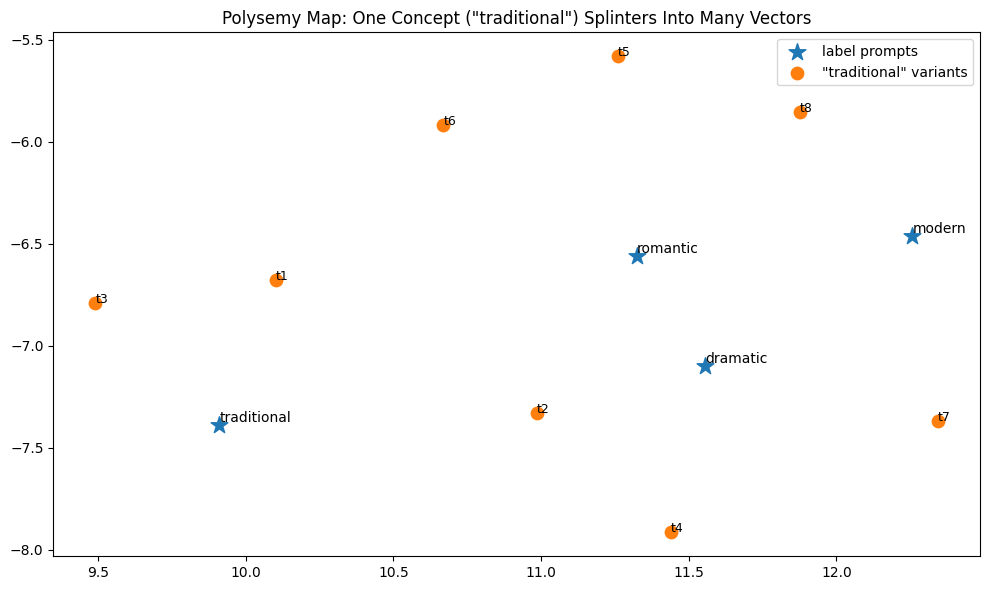

t1: a photo of a traditional wedding dress
t2: a photo of a classic wedding dress
t3: a photo of a culturally traditional wedding dress
t4: a photo of a conservative wedding dress
t5: a photo of a heritage wedding dress
t6: a photo of a vintage wedding dress
t7: a photo of a modest wedding dress
t8: a photo of a formal wedding dress


In [81]:
# Make multiple "traditional" phrasings to reveal semantic instability
traditional_variants = [
    "a photo of a traditional wedding dress",
    "a photo of a classic wedding dress",
    "a photo of a culturally traditional wedding dress",
    "a photo of a conservative wedding dress",
    "a photo of a heritage wedding dress",
    "a photo of a vintage wedding dress",
    "a photo of a modest wedding dress",
    "a photo of a formal wedding dress"
]
tv_emb = get_text_embeddings(traditional_variants)

# Reduce text points together with your label prompts for a consistent map
X_text_all = np.vstack([text_emb, tv_emb])
XY_text_all = reduce_2d(X_text_all, method="umap" if use_umap else "pca")

XY_labels = XY_text_all[:len(labels)]
XY_trad = XY_text_all[len(labels):]

plt.figure(figsize=(10,6))
plt.scatter(XY_labels[:,0], XY_labels[:,1], s=160, marker="*", label="label prompts")
for i, lab in enumerate(labels):
    plt.text(XY_labels[i,0], XY_labels[i,1], lab, fontsize=10, ha="left", va="bottom")

plt.scatter(XY_trad[:,0], XY_trad[:,1], s=80, label='"traditional" variants')
for i, t in enumerate(traditional_variants):
    plt.text(XY_trad[i,0], XY_trad[i,1], f"t{i+1}", fontsize=9)

plt.title('Polysemy Map: One Concept ("traditional") Splinters Into Many Vectors')
plt.legend()
plt.tight_layout()
plt.show()

# Print legend mapping t1..tn
for i, t in enumerate(traditional_variants, 1):
    print(f"t{i}: {t}")

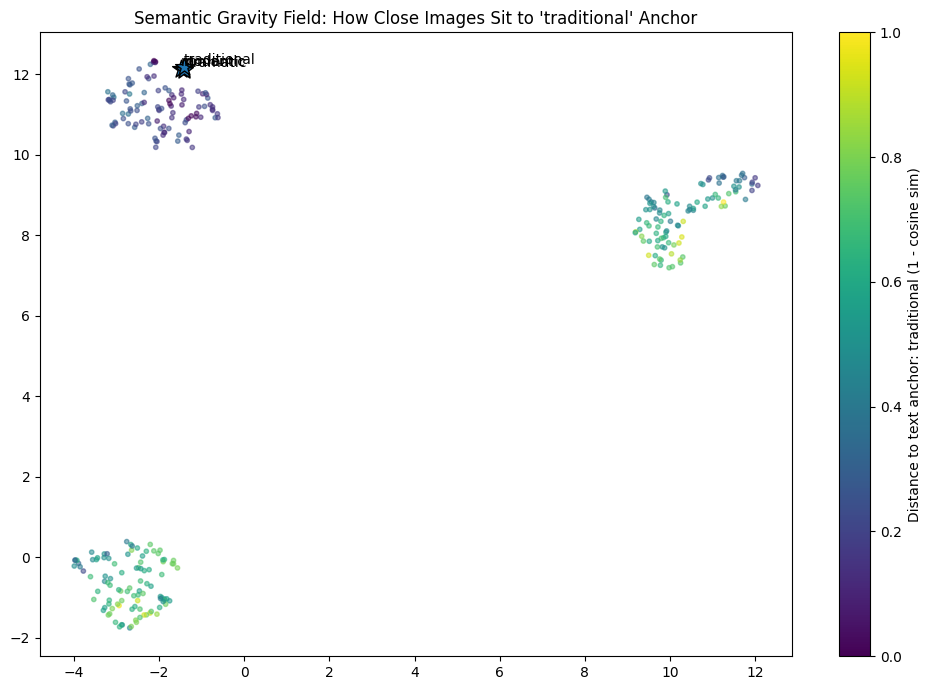

In [82]:
label_to_i = {lab:i for i, lab in enumerate(labels)}

def plot_distance_to_label(label):
    i = label_to_i[label]
    sims = all_img @ text_emb[i]  # cosine sim
    dist = 1 - sims

    plt.figure(figsize=(10,7))
    plt.scatter(df_img["x"], df_img["y"], c=dist, s=10, alpha=0.55)
    plt.scatter(df_txt["x"], df_txt["y"], s=180, marker="*", edgecolors="k")
    for _, r in df_txt.iterrows():
        plt.text(r["x"], r["y"], r["label"], fontsize=10, ha="left", va="bottom")
    plt.colorbar(label=f"Distance to text anchor: {label} (1 - cosine sim)")
    plt.title(f"Semantic Gravity Field: How Close Images Sit to '{label}' Anchor")
    plt.tight_layout()
    plt.show()

plot_distance_to_label("traditional")

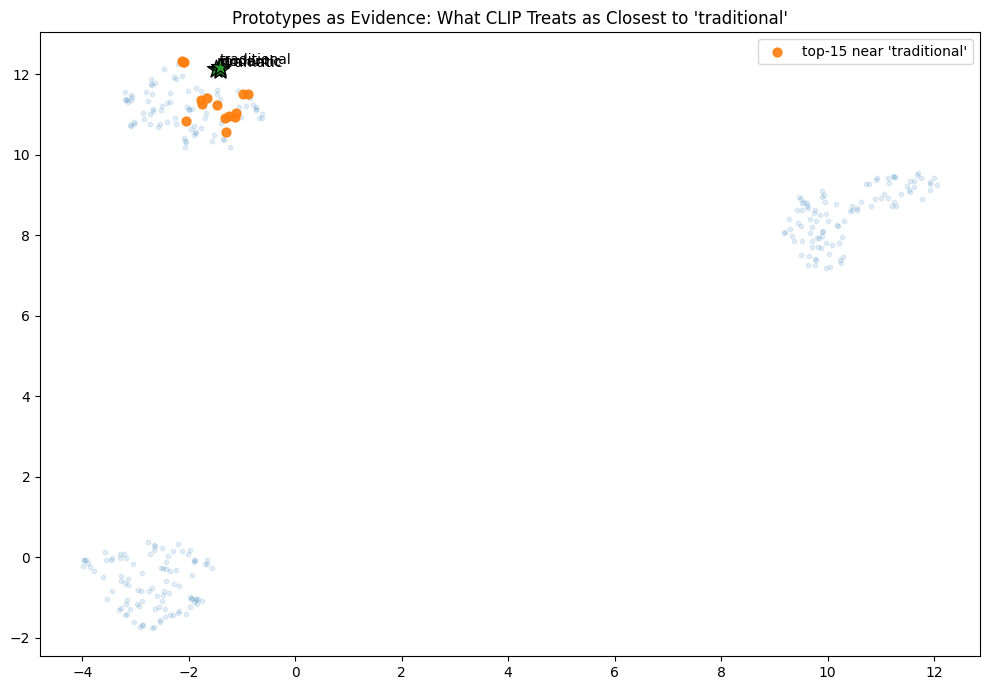

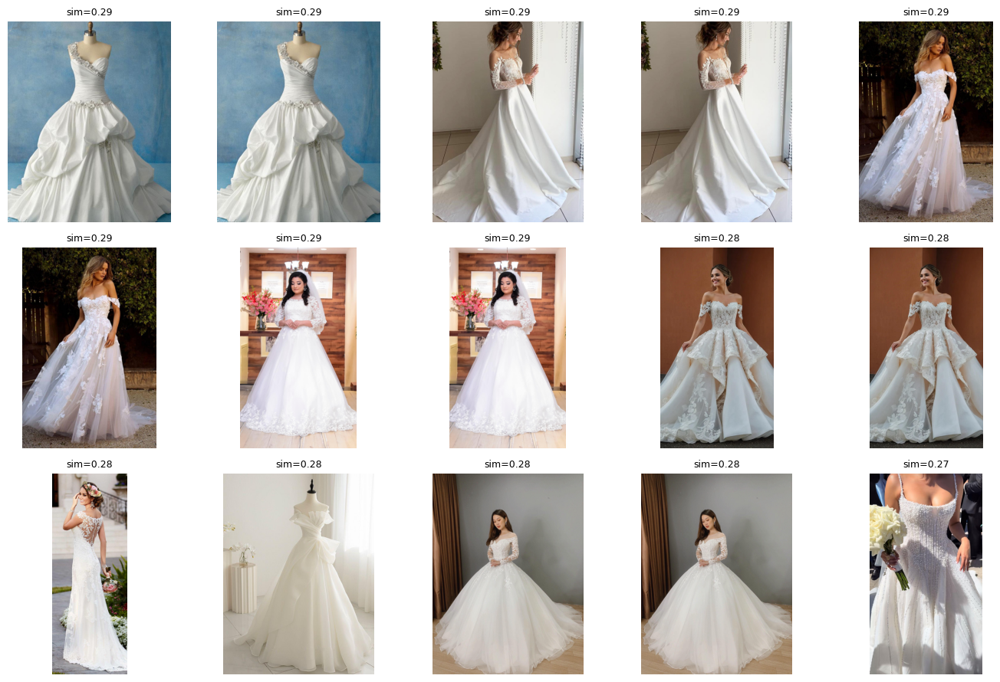

In [83]:
def show_anchor_prototypes(label, top_k=20):
    i = label_to_i[label]
    sims = all_img @ text_emb[i]
    idx = np.argsort(-sims)[:top_k]

    # show points on map
    plt.figure(figsize=(10,7))
    plt.scatter(df_img["x"], df_img["y"], s=10, alpha=0.12)
    plt.scatter(df_img.iloc[idx]["x"], df_img.iloc[idx]["y"], s=40, alpha=0.9, label=f"top-{top_k} near '{label}'")
    plt.scatter(df_txt["x"], df_txt["y"], s=180, marker="*", edgecolors="k")
    for _, r in df_txt.iterrows():
        plt.text(r["x"], r["y"], r["label"], fontsize=10, ha="left", va="bottom")

    plt.title(f"Prototypes as Evidence: What CLIP Treats as Closest to '{label}'")
    plt.legend()
    plt.tight_layout()
    plt.show()

    # show image grid (this is interpretive evidence)
    proto_paths = df_img.iloc[idx]["path"].tolist()
    titles = [f"sim={sims[j]:.2f}" for j in idx]
    show_image_grid(proto_paths, titles=titles, n_cols=5, figsize=(14,9))

show_anchor_prototypes("traditional", top_k=15)

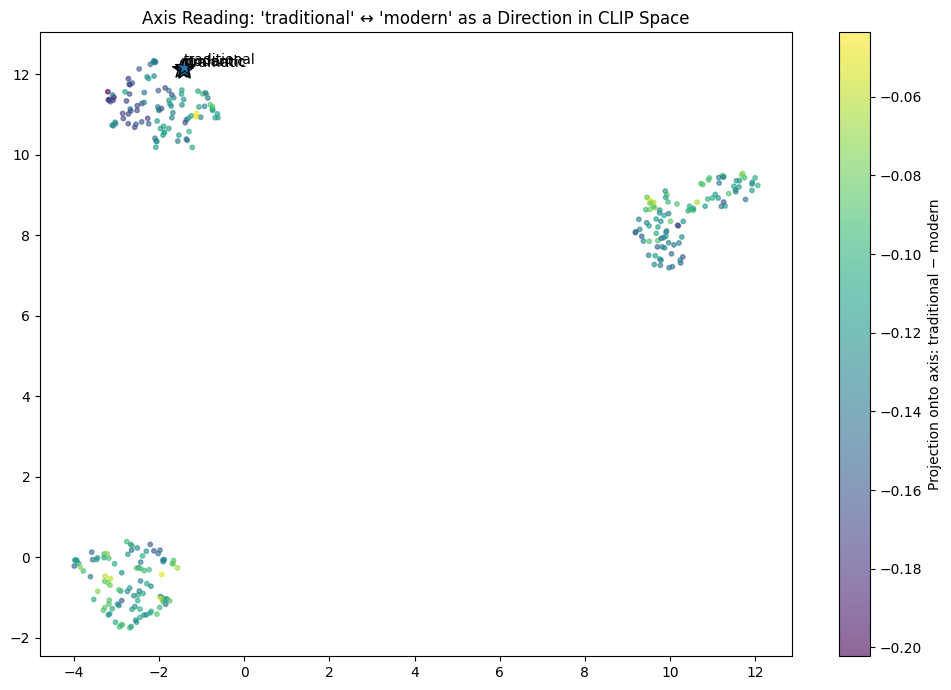

In [84]:
def plot_axis(pos_label, neg_label):
    v = text_emb[label_to_i[pos_label]] - text_emb[label_to_i[neg_label]]
    v = v / np.linalg.norm(v)
    proj = all_img @ v  # scalar

    plt.figure(figsize=(10,7))
    plt.scatter(df_img["x"], df_img["y"], c=proj, s=10, alpha=0.6)
    plt.colorbar(label=f"Projection onto axis: {pos_label} − {neg_label}")
    plt.scatter(df_txt["x"], df_txt["y"], s=180, marker="*", edgecolors="k")
    for _, r in df_txt.iterrows():
        plt.text(r["x"], r["y"], r["label"], fontsize=10, ha="left", va="bottom")
    plt.title(f"Axis Reading: '{pos_label}' ↔ '{neg_label}' as a Direction in CLIP Space")
    plt.tight_layout()
    plt.show()

plot_axis("traditional", "modern")

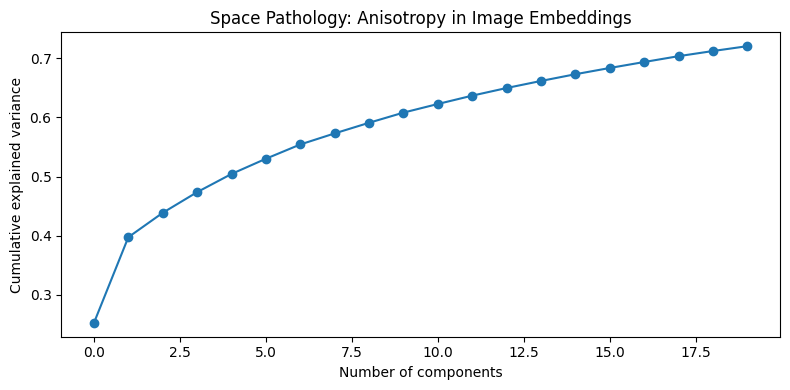

Most frequent nearest-neighbor 'hubs' (indices): [np.int64(45), np.int64(104), np.int64(200), np.int64(228), np.int64(110), np.int64(203), np.int64(20), np.int64(11), np.int64(1), np.int64(3), np.int64(112), np.int64(141)]


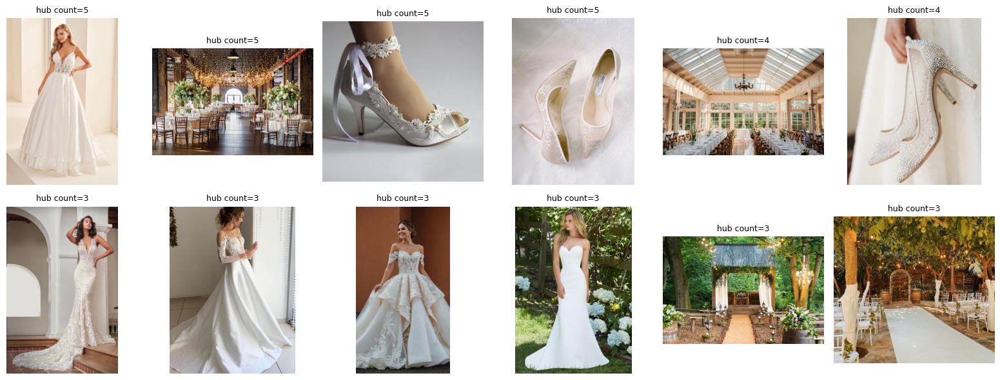

In [85]:
from sklearn.decomposition import PCA
from collections import Counter

# Anisotropy: how much variance first components explain
pca = PCA(n_components=20, random_state=42).fit(all_img)
plt.figure(figsize=(8,4))
plt.plot(np.cumsum(pca.explained_variance_ratio_), marker="o")
plt.xlabel("Number of components")
plt.ylabel("Cumulative explained variance")
plt.title("Space Pathology: Anisotropy in Image Embeddings")
plt.tight_layout()
plt.show()

# Hubness: which points appear too often as nearest neighbors
S = all_img @ all_img.T
np.fill_diagonal(S, -1)
nn = np.argmax(S, axis=1)
counts = Counter(nn)
hub_ids = [i for i,_ in counts.most_common(12)]
hub_paths = df_img.iloc[hub_ids]["path"].tolist()

print("Most frequent nearest-neighbor 'hubs' (indices):", hub_ids)
show_image_grid(hub_paths, titles=[f"hub count={counts[i]}" for i in hub_ids], n_cols=6, figsize=(16,6))